# L2 calibrated data. Tour.

### Setting up project root for module imports in Jupyter Notebook

In [1]:
# Import the os module to work with the file system
import os

# Get the absolute path of the current notebook.
# This assumes the notebook's name is "L2_tour.ipynb".
# Note: "L2_tour.ipynb" is located in the "notebooks" folder of the "oceanstream" repo.
# This folder is typically ignored to maintain a clear organization of the project.

notebook_path = os.path.abspath("L2_tour.ipynb")
print(f"notebook_path: {notebook_path}")
# Navigate up two directories from the notebook's path to get to the project root
# os.pardir represents the parent directory, so using it twice moves up two levels
project_root = os.path.abspath(os.path.join(notebook_path, os.pardir, os.pardir))

# Print the project root path to verify
print(f"project_root: {project_root}")

# Import the sys module to modify the Python path
import sys

# Append the project root to the Python path so that modules from the project can be imported
sys.path.append(project_root)

notebook_path: /Users/simedroniraluca/Documents/pineview/oceanstream/notebooks/L2_tour.ipynb
project_root: /Users/simedroniraluca/Documents/pineview/oceanstream


Specifies the path to the test data utilized in this notebook:

In [2]:
L2_tour_data_path = os.path.join(project_root, "test_data", "L2_tour_data")

### Prepare the data for analysis (L0)

In [3]:
from oceanstream.L0_unprocessed_data import(
    raw_reader,    
)

In [4]:
# Using the `file_finder` method of `raw_reader` to search for specific file types in the "L2_tour_data" directory.
# Displaying all `.raw` files from the "L2_tour_data" directory
display(raw_reader.file_finder(L2_tour_data_path, file_type='raw'))

['/Users/simedroniraluca/Documents/pineview/oceanstream/test_data/L2_tour_data/D20161109-T163350.raw',
 '/Users/simedroniraluca/Documents/pineview/oceanstream/test_data/L2_tour_data/Summer2017-D20170620-T011027.raw']

In [5]:
# Check files integirty
ek_80_info = raw_reader.file_integrity_checking(os.path.join(L2_tour_data_path, "D20161109-T163350.raw"))
ek_60_info = raw_reader.file_integrity_checking(os.path.join(L2_tour_data_path, "Summer2017-D20170620-T011027.raw"))
display(ek_80_info)
display(ek_60_info)

{'file_path': '/Users/simedroniraluca/Documents/pineview/oceanstream/test_data/L2_tour_data/D20161109-T163350.raw',
 'campaign_id': 'D20161109',
 'date': datetime.datetime(2016, 11, 9, 16, 33, 50),
 'sonar_model': 'EK80',
 'file_integrity': True}

{'file_path': '/Users/simedroniraluca/Documents/pineview/oceanstream/test_data/L2_tour_data/Summer2017-D20170620-T011027.raw',
 'campaign_id': 'Summer2017',
 'date': datetime.datetime(2017, 6, 20, 1, 10, 27),
 'sonar_model': 'EK60',
 'file_integrity': True}

In [6]:
# Read files
ek60_ek80_ds_list = raw_reader.read_raw_files([ek_60_info, ek_80_info])
ek60_ed = ek60_ek80_ds_list[0]
ek80_ed = ek60_ek80_ds_list[1]

In [7]:
ek60_ed

<EchoData: standardized raw data from Internal Memory>
Top-level: contains metadata about the SONAR-netCDF4 file format.
├── Environment: contains information relevant to acoustic propagation through water.
├── Platform: contains information about the platform on which the sonar is installed.
│   └── NMEA: contains information specific to the NMEA protocol.
├── Provenance: contains metadata about how the SONAR-netCDF4 version of the data were obtained.
├── Sonar: contains sonar system metadata and sonar beam groups.
│   └── Beam_group1: contains backscatter power (uncalibrated) and other beam or channel-specific data, including split-beam angle data when they exist.
└── Vendor_specific: contains vendor-specific information about the sonar and the data.

In [8]:
ek80_ed

<EchoData: standardized raw data from Internal Memory>
Top-level: contains metadata about the SONAR-netCDF4 file format.
├── Environment: contains information relevant to acoustic propagation through water.
├── Platform: contains information about the platform on which the sonar is installed.
│   └── NMEA: contains information specific to the NMEA protocol.
├── Provenance: contains metadata about how the SONAR-netCDF4 version of the data were obtained.
├── Sonar: contains sonar system metadata and sonar beam groups.
│   └── Beam_group1: contains complex backscatter data and other beam or channel-specific data.
└── Vendor_specific: contains vendor-specific information about the sonar and the data.

In [9]:
from oceanstream.L0_unprocessed_data import(
    ensure_time_continuity,    
)

In [10]:
# Check time continuity
print("ek60 file has time reversal: ")
display(ensure_time_continuity.check_reversed_time(ek60_ed, "Sonar/Beam_group1", "ping_time"))
print("ek80 file has time reversal: ")
display(ensure_time_continuity.check_reversed_time(ek80_ed, "Sonar/Beam_group1", "ping_time"))

ek60 file has time reversal: 


False

ek80 file has time reversal: 


False

In [11]:
display(ensure_time_continuity.check_reversed_time(ek80_ed, "Platform", "time2"))

False

### Sv (Volume backscattering strength) computation

The `EchoData` object from the `echopype` package offers a standardized format for raw echosounder datasets, encapsulating various attributes and variables that detail the echosounder's data and the conditions of its collection. A pivotal aspect of this representation is the differentiation between **Continuous Wave (CW)** and **BroadBand (BB) modes**, as well as between **power** and **complex encodings**. CW mode involves the transmission of a continuous sinusoidal signal, ideal for detecting targets at close range. In contrast, BB mode transmits a signal covering a wide range of frequencies, providing improved target resolution and potential species differentiation.

When it comes to encoding, power mode focuses on capturing the intensity of the returned echo, often represented as a singular variable like `backscatter_r`. Complex mode, on the other hand, retains both amplitude (magnitude) and phase information of the returned echo. This is evident in the presence of `backscatter_r` and `backscatter_i` variables in the data structure, signifying its complex nature. The magnitude of the complex backscatter is computed as:
$$\text{Magnitude} = \sqrt{\text{backscatter}_r^2 + \text{backscatter}_i^2}$$
Here, `backscatter_r` represents the real (in-phase) component, aligning with the transmitted signal's phase, while `backscatter_i` denotes the imaginary (quadrature) component, offering insights into the phase shift of the received signal.

Even in power mode, it's possible to determine alongship and athwartship angles, which represent the angles of the received echo relative to the ship's heading and its perpendicular direction, respectively. These angles are important for beamforming and target localization, allowing for the precise determination of target positions in the water column.

The magnitude, derived from both the real and imaginary components, indicates the overall strength of the returned echo, and it's this magnitude that `echopype` uses in the `compute_Sv` function to accurately calculate the volume backscattering strength (Sv). The phase, on the other hand, provides information about the relative motion of targets and can be important for certain analyses.

In [12]:
from oceanstream.L2_calibrated_data import(
    sv_computation,    
)

In [13]:
sv_60_ds = sv_computation.compute_sv(ek60_ed)
sv_80_ds = sv_computation.compute_sv(ek80_ed, waveform_mode="CW", encode_mode="complex")

In [14]:
sv_60_ds

<xarray.Dataset>
Dimensions:                        (channel: 3, ping_time: 1932,
                                    range_sample: 1055, filenames: 1)
Coordinates:
  * channel                        (channel) <U37 'GPT  18 kHz 009072058c8d 1...
  * ping_time                      (ping_time) datetime64[ns] 2017-06-20T01:1...
  * range_sample                   (range_sample) int64 0 1 2 ... 1052 1053 1054
  * filenames                      (filenames) int64 0
Data variables: (12/16)
    Sv                             (channel, ping_time, range_sample) float64 ...
    echo_range                     (channel, ping_time, range_sample) float64 ...
    frequency_nominal              (channel) float64 1.8e+04 3.8e+04 1.2e+05
    sound_speed                    (channel, ping_time) float64 1.481e+03 ......
    sound_absorption               (channel, ping_time) float64 0.002822 ... ...
    sa_correction                  (ping_time, channel) float64 -0.83 ... -0.34
    ...                             ...
    angle_sensitivity_alongship    (channel) float64 13.89 21.97 23.12
    angle_sensitivity_athwartship  (channel) float64 13.89 21.97 23.12
    beamwidth_alongship            (channel) float64 10.3 6.8 7.3
    beamwidth_athwartship          (channel) float64 10.3 6.8 7.2
    source_filenames               (filenames) <U109 '/Users/simedroniraluca/...
    water_level                    float64 9.15
Attributes:
    processing_software_name:     echopype
    processing_software_version:  0.1.dev2324+gf12819d
    processing_time:              2023-10-12T12:30:10Z
    processing_function:          calibrate.compute_Sv

In [15]:
sv_80_ds

<xarray.Dataset>
Dimensions:                        (channel: 5, ping_time: 13,
                                    range_sample: 123897, filenames: 1)
Coordinates:
  * channel                        (channel) <U22 'WBT 545604-15 ES38B' ... '...
  * ping_time                      (ping_time) datetime64[ns] 2016-11-09T16:3...
  * range_sample                   (range_sample) int64 0 1 2 ... 123895 123896
  * filenames                      (filenames) int64 0
Data variables: (12/24)
    Sv                             (channel, ping_time, range_sample) float64 ...
    echo_range                     (channel, ping_time, range_sample) float64 ...
    frequency_nominal              (channel) float64 3.8e+04 1.8e+04 ... 7e+04
    sound_speed                    float64 1.514e+03
    sound_absorption               (channel) float64 0.007929 ... 0.01852
    temperature                    float64 10.0
    ...                             ...
    beamwidth_athwartship          (channel) float64 7.1 11.0 7.0 7.0 7.0
    impedance_transducer           (channel) int64 75 75 75 75 75
    impedance_transceiver          int64 1000
    receiver_sampling_frequency    (channel) int64 1500000 1500000 ... 1500000
    source_filenames               (filenames) <U98 '/Users/simedroniraluca/D...
    water_level                    float64 nan
Attributes:
    processing_software_name:     echopype
    processing_software_version:  0.1.dev2324+gf12819d
    processing_time:              2023-10-12T12:30:13Z
    processing_function:          calibrate.compute_Sv

In [16]:
import echopype.visualize as epviz

#### Sv - ek60 - echogram - with noise

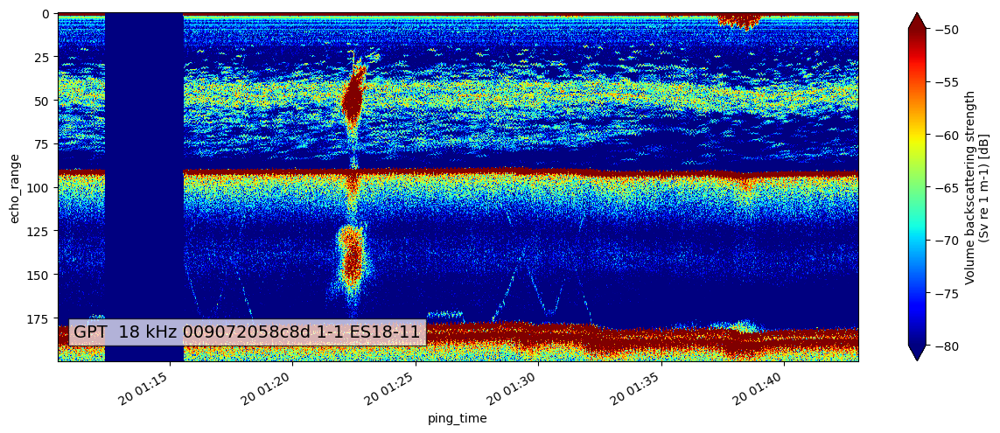

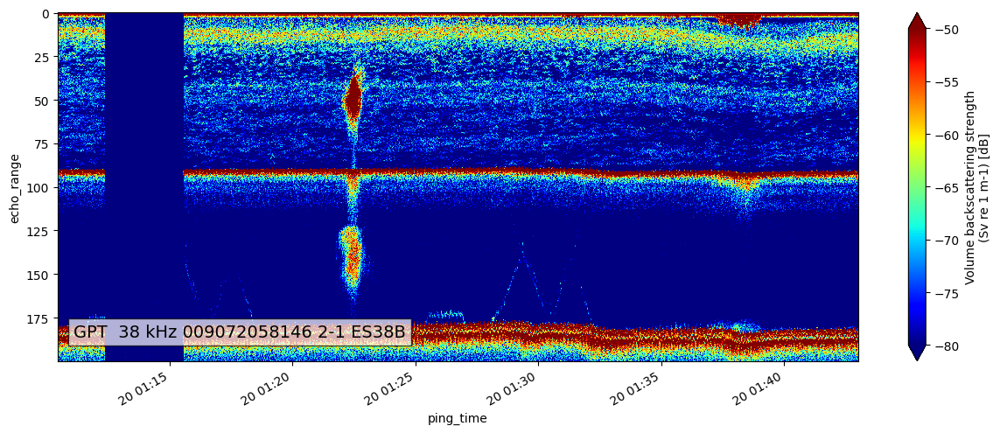

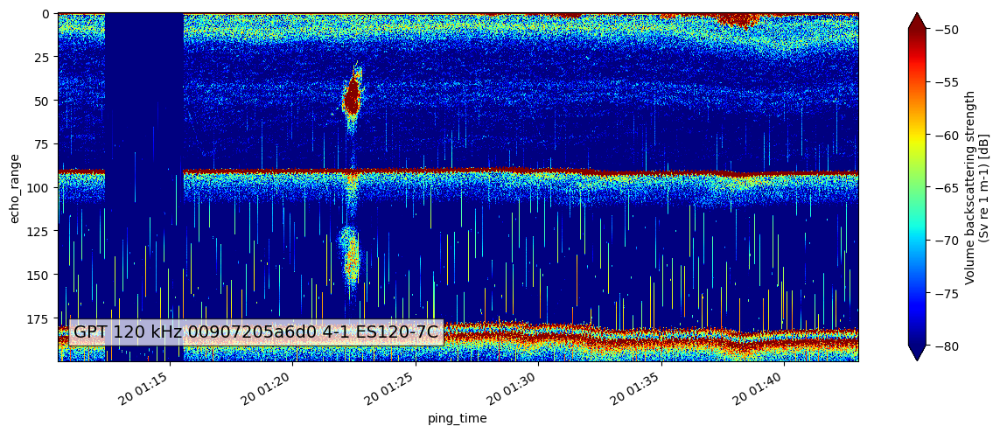

In [17]:
epviz.create_echogram(sv_60_ds,vmin=-80,vmax=-50)

#### Sv - ek80 - echogram - with noise

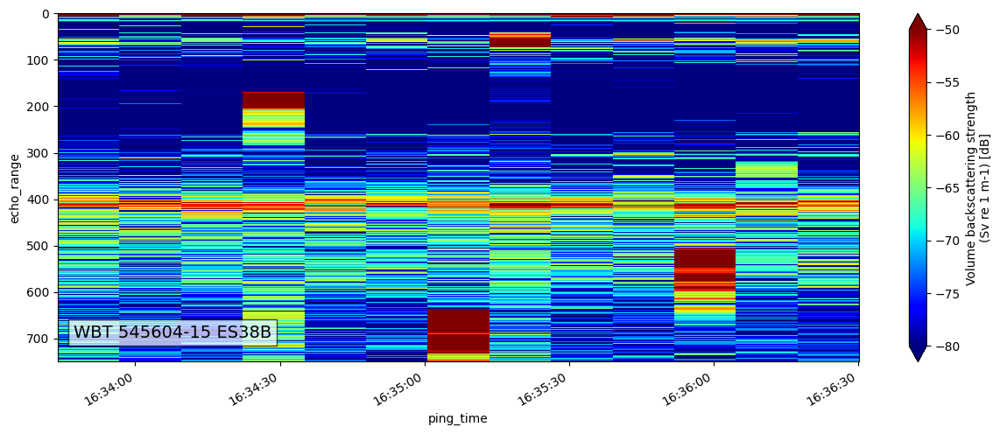

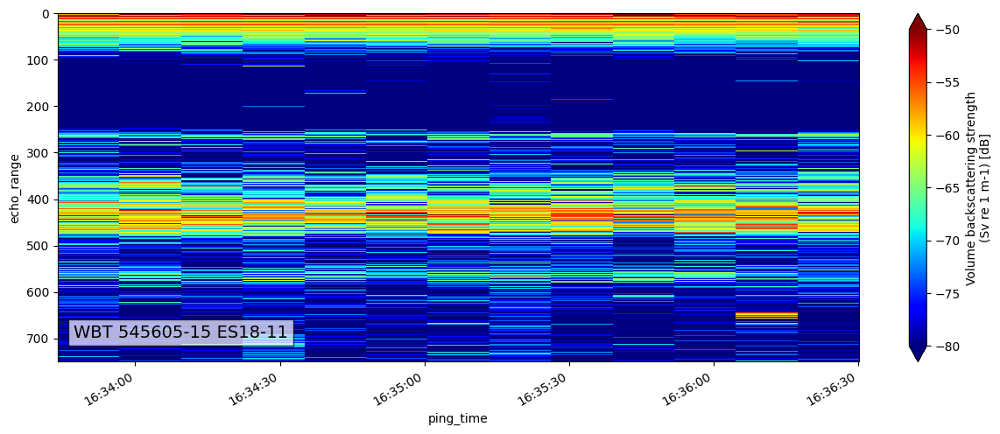

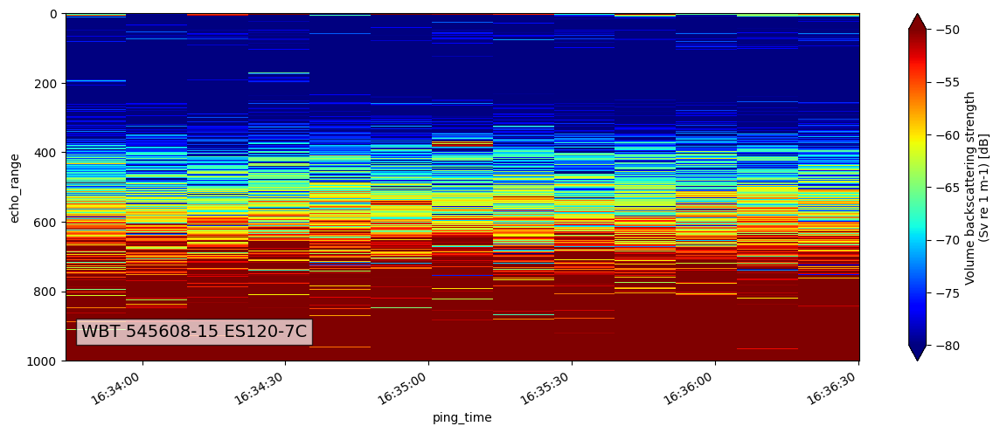

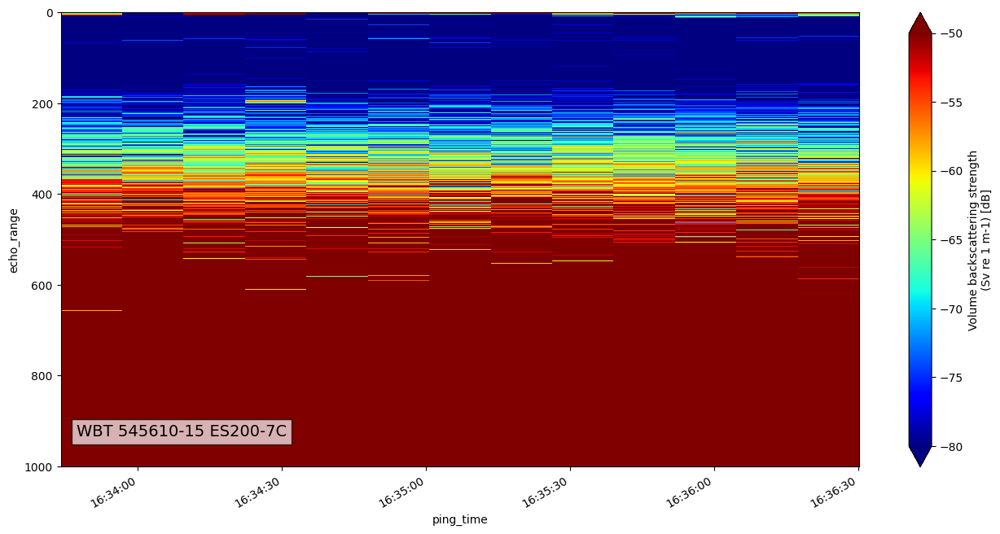

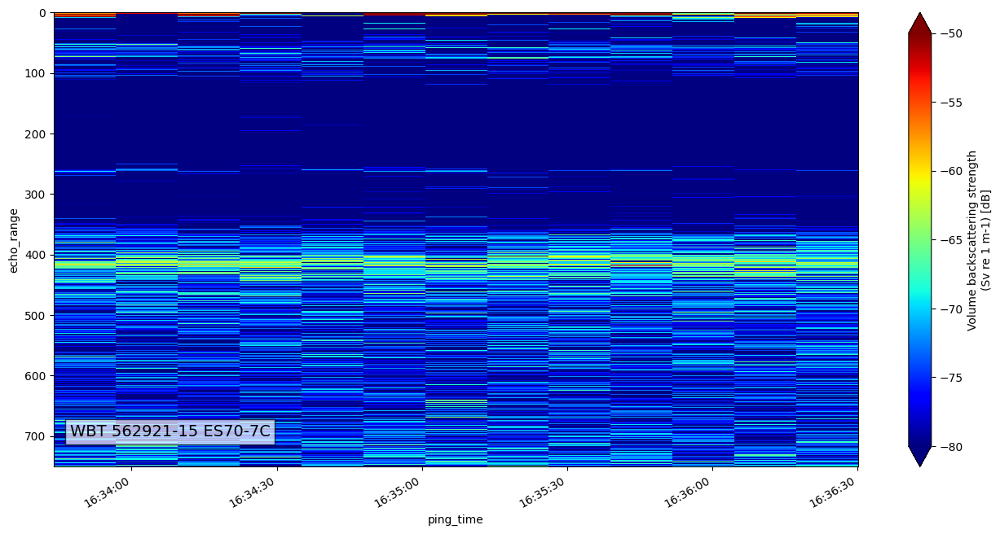

In [18]:
selected_channels = sv_80_ds.sel(channel=['WBT 545604-15 ES38B', 'WBT 545605-15 ES18-11', 'WBT 545608-15 ES120-7C'])
epviz.create_echogram(selected_channels,vmin=-80,vmax=-50)
selected_channels = sv_80_ds.sel(channel=['WBT 545610-15 ES200-7C', 'WBT 562921-15 ES70-7C'])
epviz.create_echogram(selected_channels,vmin=-80,vmax=-50)

### Sv dataset extension

In [19]:
from oceanstream.L2_calibrated_data import(
    sv_dataset_extension
)

In [20]:
extended_sv_60_ds = sv_dataset_extension.enrich_sv_dataset(sv = sv_60_ds, 
                                                           echodata = ek60_ed, 
                                                           waveform_mode="CW", 
                                                           encode_mode="power")
extended_sv_60_ds

<xarray.Dataset>
Dimensions:                        (channel: 3, ping_time: 1932,
                                    range_sample: 1055, filenames: 1)
Coordinates:
  * channel                        (channel) <U37 'GPT  18 kHz 009072058c8d 1...
  * ping_time                      (ping_time) datetime64[ns] 2017-06-20T01:1...
  * range_sample                   (range_sample) int64 0 1 2 ... 1052 1053 1054
  * filenames                      (filenames) int64 0
Data variables: (12/21)
    Sv                             (channel, ping_time, range_sample) float64 ...
    echo_range                     (channel, ping_time, range_sample) float64 ...
    frequency_nominal              (channel) float64 1.8e+04 3.8e+04 1.2e+05
    sound_speed                    (channel, ping_time) float64 1.481e+03 ......
    sound_absorption               (channel, ping_time) float64 0.002822 ... ...
    sa_correction                  (ping_time, channel) float64 -0.83 ... -0.34
    ...                             ...
    water_level                    float64 9.15
    depth                          (channel, ping_time, range_sample) float64 ...
    latitude                       (ping_time) float64 nan 44.71 ... 44.7 44.7
    longitude                      (ping_time) float64 nan -124.3 ... -124.4
    angle_alongship                (channel, ping_time, range_sample) float64 ...
    angle_athwartship              (channel, ping_time, range_sample) float64 ...
Attributes:
    processing_software_name:     echopype
    processing_software_version:  0.1.dev2324+gf12819d
    processing_time:              2023-10-12T12:30:10Z
    processing_function:          calibrate.compute_Sv
    processing_level:             Level 2A
    processing_level_url:         https://echopype.readthedocs.io/en/stable/p...

In [21]:
extended_sv_80_ds = sv_dataset_extension.enrich_sv_dataset(sv = sv_80_ds,
                                                           echodata = ek80_ed, 
                                                           waveform_mode="CW", 
                                                           encode_mode="complex")
extended_sv_80_ds

/Users/simedroniraluca/Documents/pineview/oceanstream/oceanstream/L2_calibrated_data/sv_dataset_extension.py:70: UserWarning: Failed to add location due to error: Reindexing only valid with uniquely valued Index objects
  warnings.warn(f"Failed to add location due to error: {str(e)}")


<xarray.Dataset>
Dimensions:                        (channel: 5, ping_time: 13,
                                    range_sample: 123897, filenames: 1)
Coordinates:
  * channel                        (channel) <U22 'WBT 545604-15 ES38B' ... '...
  * ping_time                      (ping_time) datetime64[ns] 2016-11-09T16:3...
  * range_sample                   (range_sample) int64 0 1 2 ... 123895 123896
  * filenames                      (filenames) int64 0
Data variables: (12/27)
    Sv                             (channel, ping_time, range_sample) float64 ...
    echo_range                     (channel, ping_time, range_sample) float64 ...
    frequency_nominal              (channel) float64 3.8e+04 1.8e+04 ... 7e+04
    sound_speed                    float64 1.514e+03
    sound_absorption               (channel) float64 0.007929 ... 0.01852
    temperature                    float64 10.0
    ...                             ...
    receiver_sampling_frequency    (channel) int64 1500000 1500000 ... 1500000
    source_filenames               (filenames) <U98 '/Users/simedroniraluca/D...
    water_level                    float64 nan
    depth                          (channel, ping_time, range_sample) float64 ...
    angle_alongship                (channel, ping_time, range_sample) float64 ...
    angle_athwartship              (channel, ping_time, range_sample) float64 ...
Attributes:
    processing_software_name:     echopype
    processing_software_version:  0.1.dev2324+gf12819d
    processing_time:              2023-10-12T12:30:13Z
    processing_function:          calibrate.compute_Sv

### Noise masks

**Based on the article:**  
[Haris, K., et al. "Sounding out life in the deep using acoustic data from ships of opportunity." Scientific Data 8.1 (2021): 23.](https://www.nature.com/articles/s41597-020-00785-8)

The order of cleaning process steps should be to find and apply:
1. `Impulse noise mask`
2. `Attenuated signal mask`
3. `Transient noise mask`
4. `Background noise mask`

This sequence is explicitly illustrated in "Figure 5" of the article (also attached below). The `false seabed` should be identified and eliminated before the steps enumerated above. While this isn't explicitly mentioned in the article, it can be inferred.

For more on background noise, refer to the article ["A post-processing technique to estimate the signal-to-noise ratio and remove echosounder background noise" published in ICES Journal of Marine Sciences (64(6): 1282–1291)](https://academic.oup.com/icesjms/article/64/6/1282/616894). This source further explains why background noise should be eliminated after the impulse noise, attenuated signal, and transient noise have been addressed.

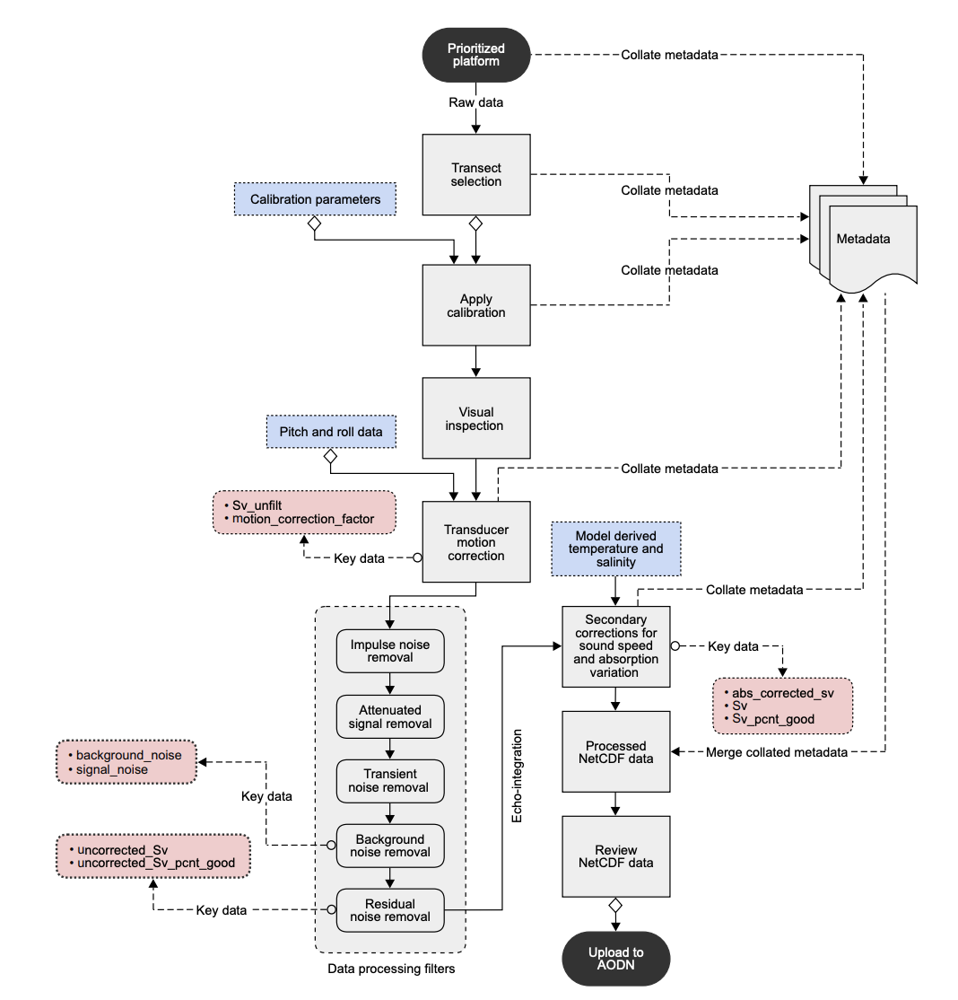

In [22]:
from IPython.display import display, Image
display(Image(filename=os.path.join(project_root, "notebooks", "denoise_stepts.png")))

In [23]:
import time

import echopype as ep

from oceanstream.L2_calibrated_data import noise_masks


**EK60 - Noise masks**

- **Compute noise masks and add them as variables to the dataset (using `noise_masks.create_noise_masks_rapidkrill` function)**
- Notes:
    - To effectively utilize the `blackwell` method for seabed detection, ensure that the `Sv` dataset includes the `split-beam angle` parameters. Specifically, the input `Sv` dataset should contain both the `angle_alongship` and `angle_athwartship` variables. The absence of these variables will lead to errors. Therefore, `extended_sv_60_ds` must be used.

In [24]:
%time
rapidkrill_ek60_extended_ds = noise_masks.create_noise_masks_rapidkrill(extended_sv_60_ds)

CPU times: user 2 µs, sys: 0 ns, total: 2 µs
Wall time: 5.25 µs


In [25]:
# See how the dataset looks
rapidkrill_ek60_extended_ds

<xarray.Dataset>
Dimensions:                        (channel: 3, ping_time: 1932,
                                    range_sample: 1055, filenames: 1)
Coordinates:
  * channel                        (channel) object 'GPT  18 kHz 009072058c8d...
  * ping_time                      (ping_time) datetime64[ns] 2017-06-20T01:1...
  * range_sample                   (range_sample) int64 0 1 2 ... 1052 1053 1054
  * filenames                      (filenames) int64 0
Data variables: (12/26)
    Sv                             (channel, ping_time, range_sample) float64 ...
    echo_range                     (channel, ping_time, range_sample) float64 ...
    frequency_nominal              (channel) float64 1.8e+04 3.8e+04 1.2e+05
    sound_speed                    (channel, ping_time) float64 1.481e+03 ......
    sound_absorption               (channel, ping_time) float64 0.002822 ... ...
    sa_correction                  (ping_time, channel) float64 -0.83 ... -0.34
    ...                             ...
    angle_athwartship              (channel, ping_time, range_sample) float64 ...
    mask_transient                 (channel, ping_time, range_sample) bool Tr...
    mask_impulse                   (channel, ping_time, range_sample) bool Tr...
    mask_attenuation               (channel, ping_time, range_sample) bool Fa...
    mask_seabed                    (channel, ping_time, range_sample) bool Tr...
    mask_false_seabed              (channel, ping_time, range_sample) bool Tr...
Attributes:
    processing_software_name:     echopype
    processing_software_version:  0.1.dev2324+gf12819d
    processing_time:              2023-10-12T12:30:10Z
    processing_function:          calibrate.compute_Sv
    processing_level:             Level 2A
    processing_level_url:         https://echopype.readthedocs.io/en/stable/p...

- `Apply only seabed mask` - applying the seabed mask obtained using the method from the noise_masks.create_noise_masks_rapidkrill function, with method=`ariza`

In [26]:
rapidkrill_ds_no_false_seabed = ep.mask.apply_mask(
    rapidkrill_ek60_extended_ds,
    rapidkrill_ek60_extended_ds['mask_seabed']
)


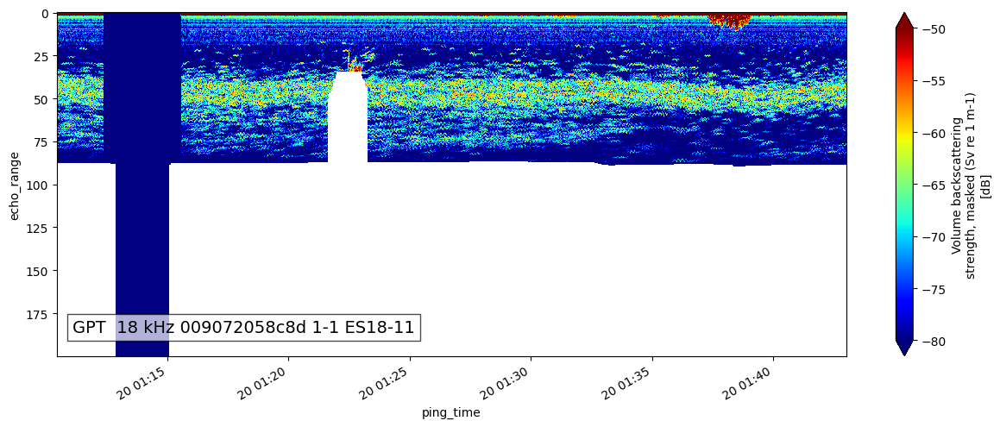

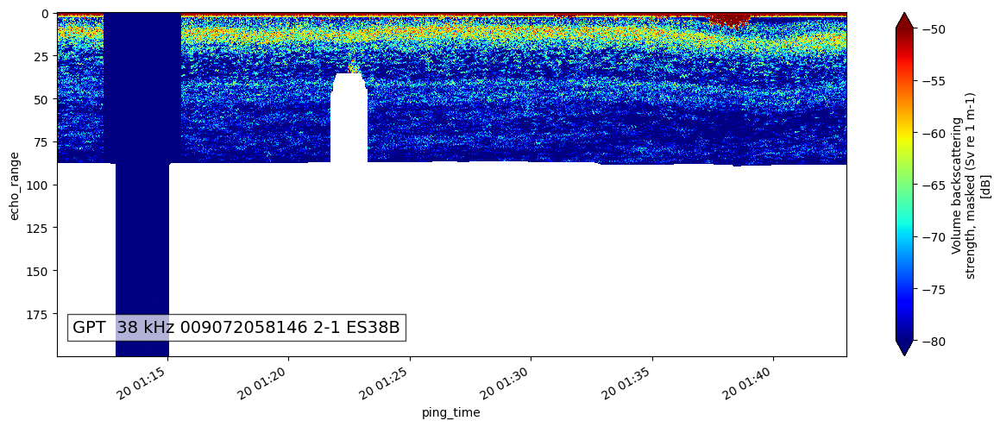

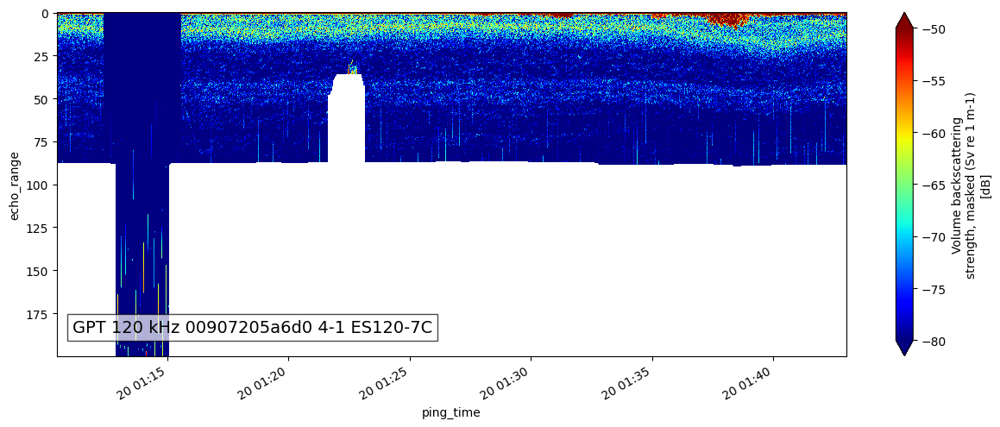

In [27]:
epviz.create_echogram(rapidkrill_ds_no_false_seabed,vmin=-80,vmax=-50)

- `Apply only false seabed mask` - applying the false seabed mask obtained using the method from the noise_masks.create_noise_masks_rapidkrill function, with method=`blackwell`

In [28]:
rapidkrill_ds_no_seabed = ep.mask.apply_mask(
    rapidkrill_ek60_extended_ds,
    rapidkrill_ek60_extended_ds['mask_false_seabed']
)

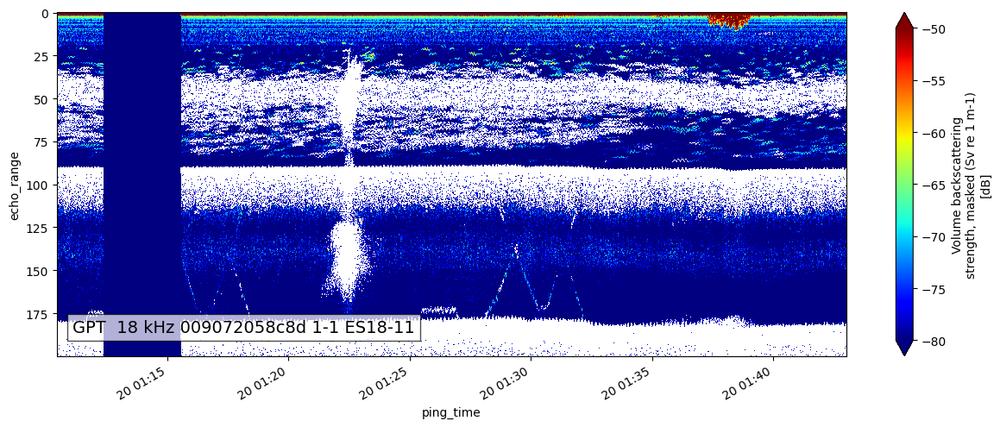

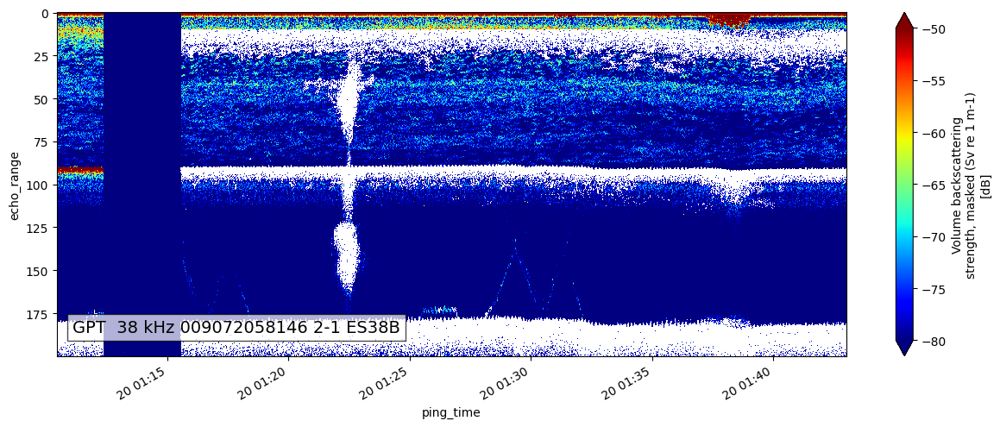

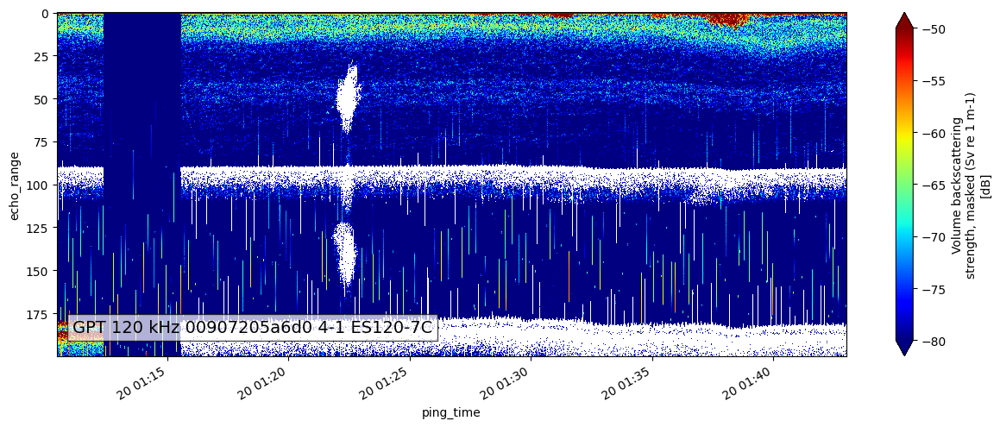

In [29]:
epviz.create_echogram(rapidkrill_ds_no_seabed,vmin=-80,vmax=-50)

- `Apply only false seabed mask` - applying the false seabed mask obtained using the **noise_masks.create_seabed_mask function**, with method=`blackwell_mod`

In [30]:
from oceanstream.utils import add_metadata_to_mask, attach_mask_to_dataset, dict_to_formatted_list

BLACKWELL_MOD_DEFAULT_PARAMS = {
    "theta": None,
    "phi": None,
    "r0": 10,
    "r1": 1000,
    "tSv": -75,
    "ttheta": 702,
    "tphi": 282,
    "wtheta": 28,
    "wphi": 52,
    "rlog": None,
    "tpi": None,
    "freq": None,
    "rank": 50,
}
ds_no_seabed_blackwell_mod_mask = noise_masks.create_seabed_mask(
    rapidkrill_ek60_extended_ds,
    method="blackwell_mod",
    parameters = BLACKWELL_MOD_DEFAULT_PARAMS,
    )
ds_no_seabed_blackwell_mod_mask = add_metadata_to_mask(
    mask=ds_no_seabed_blackwell_mod_mask , metadata={
        "mask_type": "blackwell_mod_false_seabed", 
        "method":"blackwell_mod",
        "parameters": dict_to_formatted_list(BLACKWELL_MOD_DEFAULT_PARAMS),
    }
)

rapidkrill_ek60_extended_ds = attach_mask_to_dataset(
    rapidkrill_ek60_extended_ds, 
    ds_no_seabed_blackwell_mod_mask
)

ds_no_seabed_blackwell_mod = ep.mask.apply_mask(
    rapidkrill_ek60_extended_ds,
    ds_no_seabed_blackwell_mod_mask 
)

In [31]:
ds_no_seabed_blackwell_mod_mask

<xarray.DataArray (channel: 3, ping_time: 1932, range_sample: 1055)>
array([[[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True]],

       [[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [ True,  True,  True, ..., False, False,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True]],

       [[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True]]])
Coordinates:
  * ping_time     (ping_time) datetime64[ns] 2017-06-20T01:10:27.137830912 .....
  * range_sample  (range_sample) int64 0 1 2 3 4 5 ... 1050 1051 1052 1053 1054
  * channel       (channel) object 'GPT  18 kHz 009072058c8d 1-1 ES18-11' ......
Attributes:
    mask_type:   blackwell_mod_false_seabed
    method:      blackwell_mod
    parameters:  ['theta=None', 'phi=None', 'r0=10', 'r1=1000', 'tSv=-75', 't...

In [32]:
ds_no_seabed_blackwell_mod

<xarray.Dataset>
Dimensions:                          (channel: 3, ping_time: 1932,
                                      range_sample: 1055, filenames: 1)
Coordinates:
  * channel                          (channel) object 'GPT  18 kHz 009072058c...
  * ping_time                        (ping_time) datetime64[ns] 2017-06-20T01...
  * range_sample                     (range_sample) int64 0 1 2 ... 1053 1054
  * filenames                        (filenames) int64 0
Data variables: (12/27)
    Sv                               (channel, ping_time, range_sample) float64 ...
    echo_range                       (channel, ping_time, range_sample) float64 ...
    frequency_nominal                (channel) float64 1.8e+04 3.8e+04 1.2e+05
    sound_speed                      (channel, ping_time) float64 1.481e+03 ....
    sound_absorption                 (channel, ping_time) float64 0.002822 .....
    sa_correction                    (ping_time, channel) float64 -0.83 ... -...
    ...                               ...
    mask_transient                   (channel, ping_time, range_sample) bool ...
    mask_impulse                     (channel, ping_time, range_sample) bool ...
    mask_attenuation                 (channel, ping_time, range_sample) bool ...
    mask_seabed                      (channel, ping_time, range_sample) bool ...
    mask_false_seabed                (channel, ping_time, range_sample) bool ...
    mask_blackwell_mod_false_seabed  (channel, ping_time, range_sample) bool ...
Attributes:
    processing_software_name:     echopype
    processing_software_version:  0.1.dev2324+gf12819d
    processing_time:              2023-10-12T12:30:10Z
    processing_function:          calibrate.compute_Sv
    processing_level:             Level 3A
    processing_level_url:         https://echopype.readthedocs.io/en/stable/p...
    mask_software_name:           echopype
    mask_software_version:        0.1.dev2324+gf12819d
    mask_time:                    2023-10-12T12:32:14Z
    mask_function:                mask.apply_mask

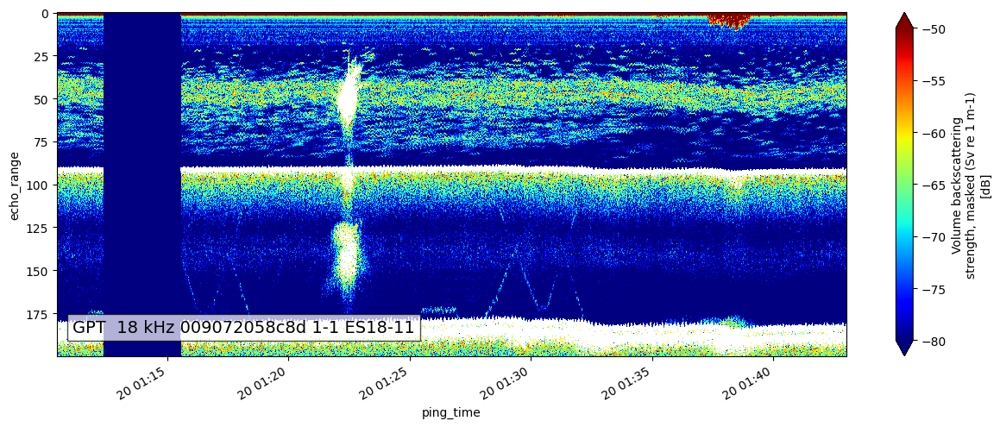

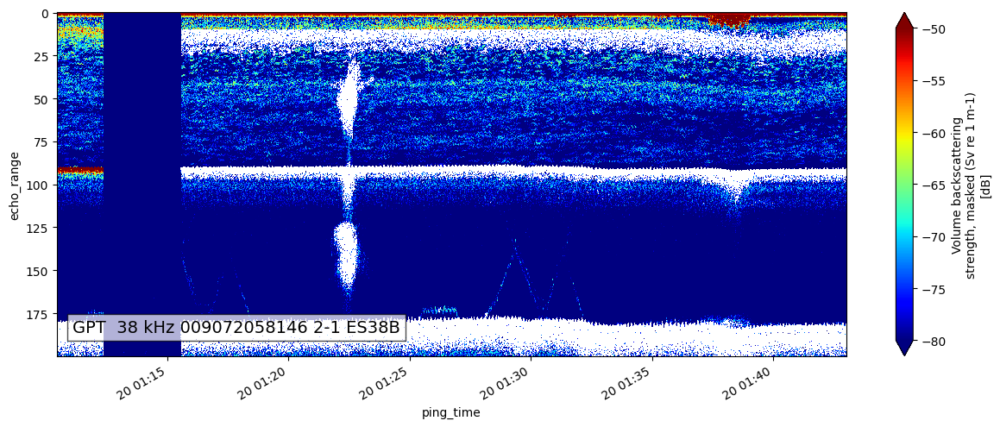

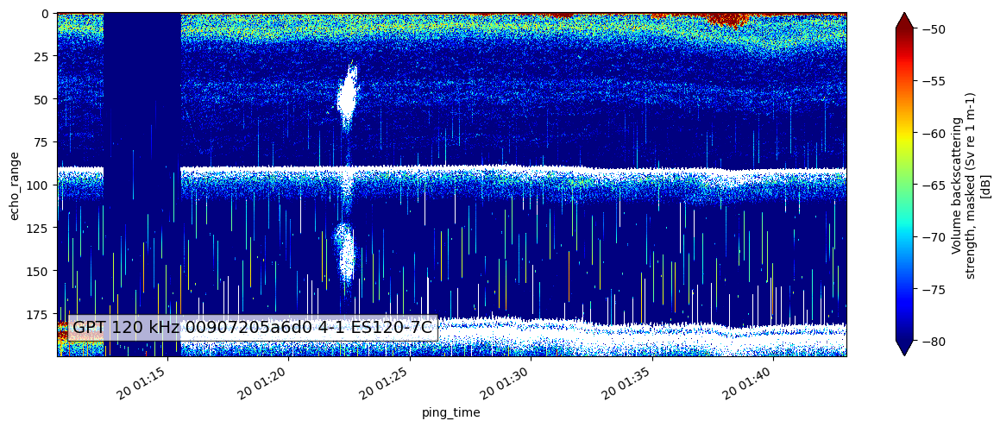

In [33]:
epviz.create_echogram(ds_no_seabed_blackwell_mod, vmin=-80,vmax=-50)

**Remark**: The false bottom detection shouldn't be applied by default. As demonstrated in the example above, it might inadvertently mask valuable signal.

`Apply only impulse noise mask`
- applying the impulse noise mask obtained using the method from the noise_masks.create_noise_masks_rapidkrill function, with method=`ryan`

In [34]:
rapidkrill_ds_no_impulse_noise = ep.mask.apply_mask(
    rapidkrill_ek60_extended_ds,
    rapidkrill_ek60_extended_ds['mask_impulse']
)

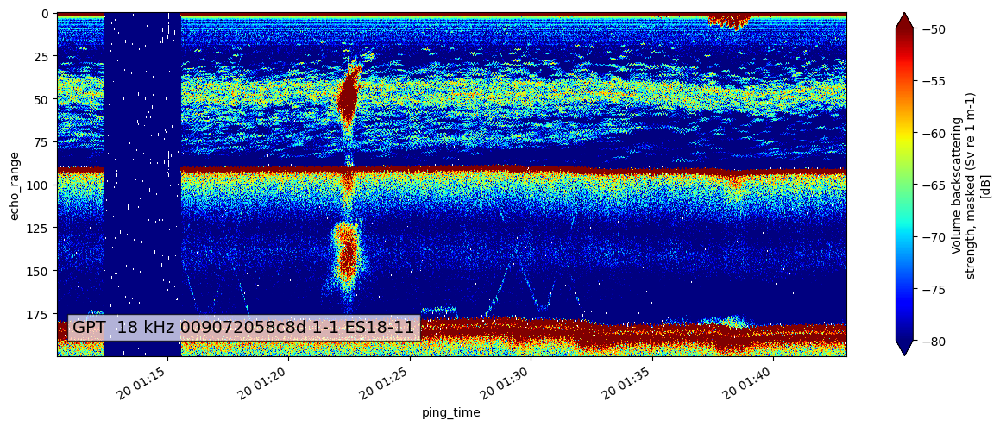

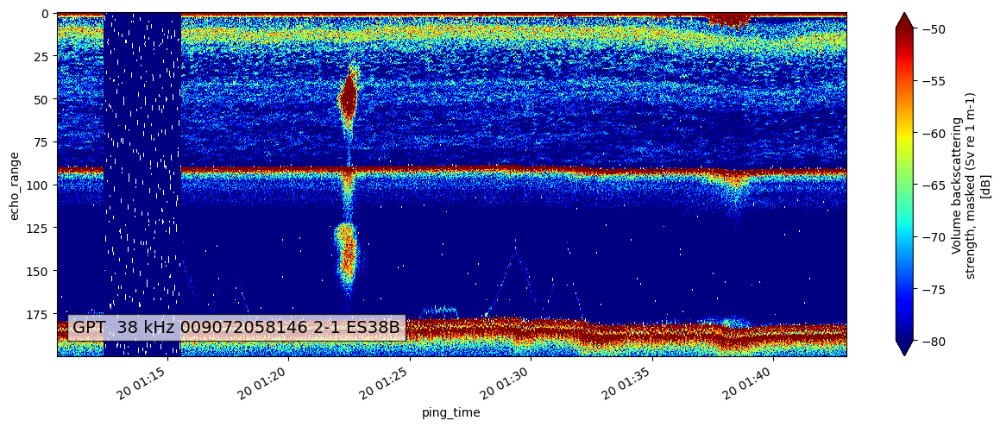

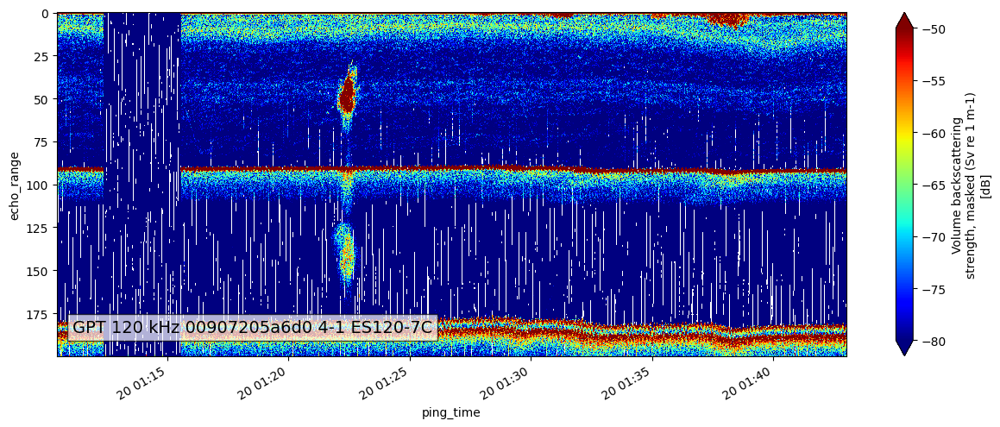

In [35]:
epviz.create_echogram(rapidkrill_ds_no_impulse_noise,vmin=-80,vmax=-50)

`Apply only attenuation mask `
- applying the attenuation mask obtained using the method from the noise_masks.create_noise_masks_rapidkrill function, with method=`ryan`

In [36]:
rapidkrill_ds_no_attenuation = ep.mask.apply_mask(
    rapidkrill_ek60_extended_ds,
    rapidkrill_ek60_extended_ds['mask_attenuation']
)

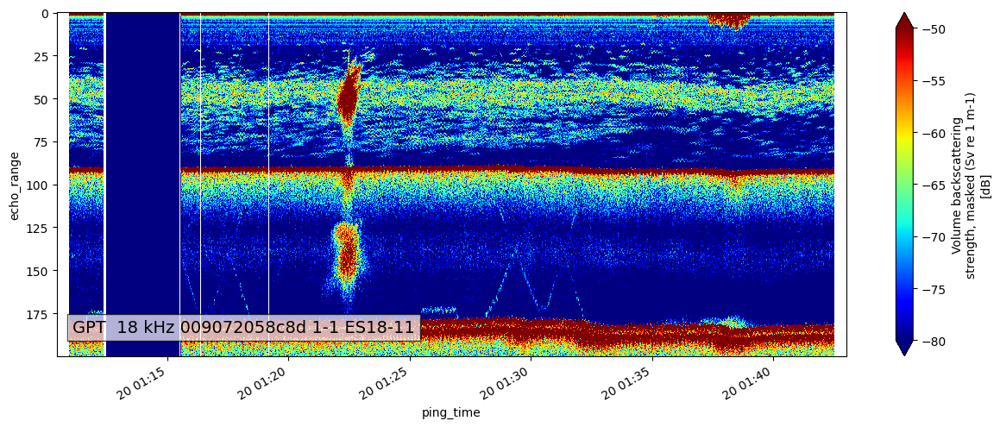

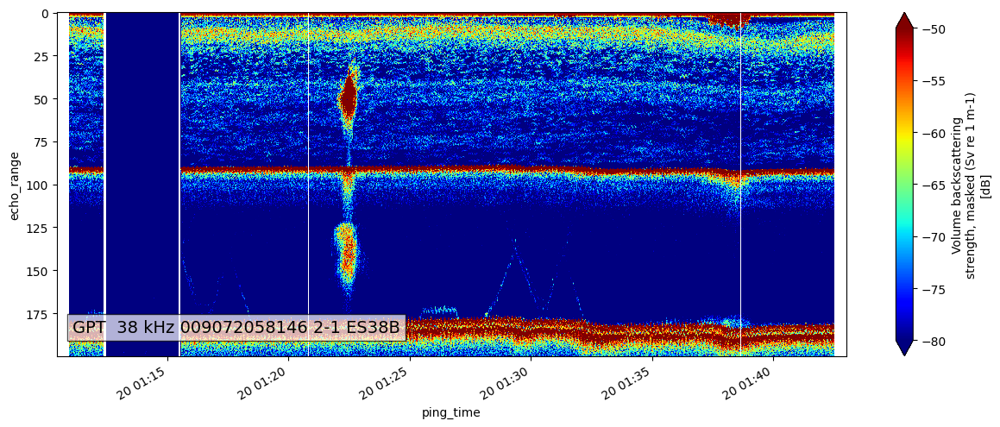

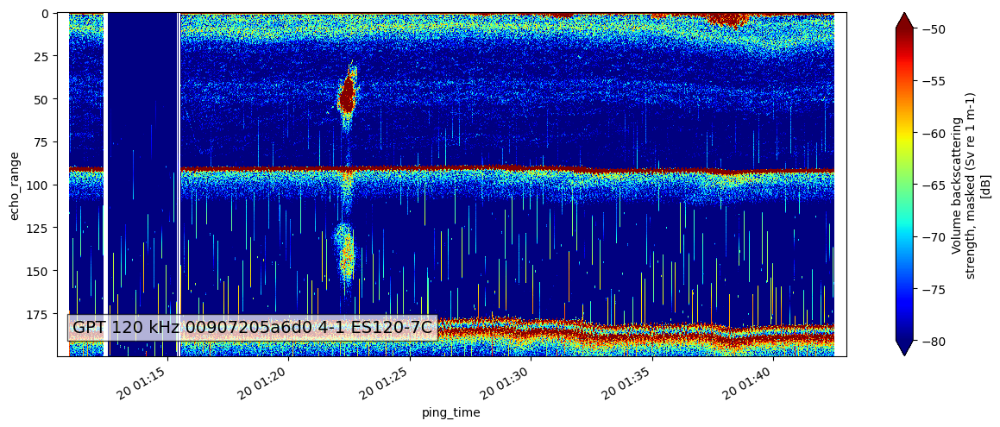

In [37]:
epviz.create_echogram(rapidkrill_ds_no_attenuation,vmin=-80,vmax=-50)

`Apply only transient mask`
- applying the transient mask obtained using the method from the noise_masks.create_noise_masks_rapidkrill function, with method=`ryan`

In [38]:
rapidkrill_ds_no_transient = ep.mask.apply_mask(
    rapidkrill_ek60_extended_ds,
    rapidkrill_ek60_extended_ds['mask_transient']
)

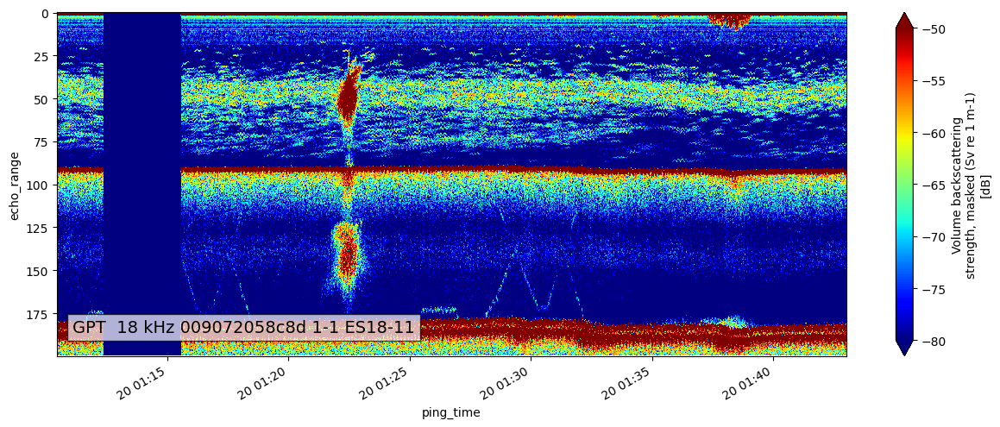

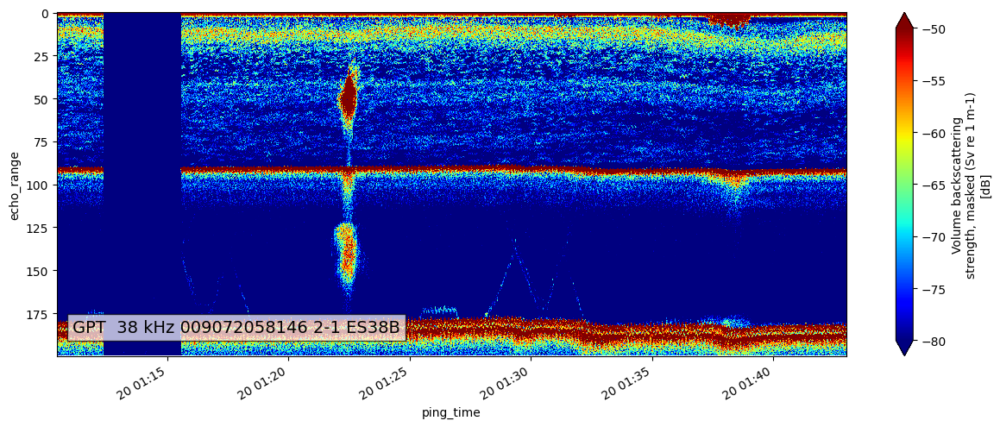

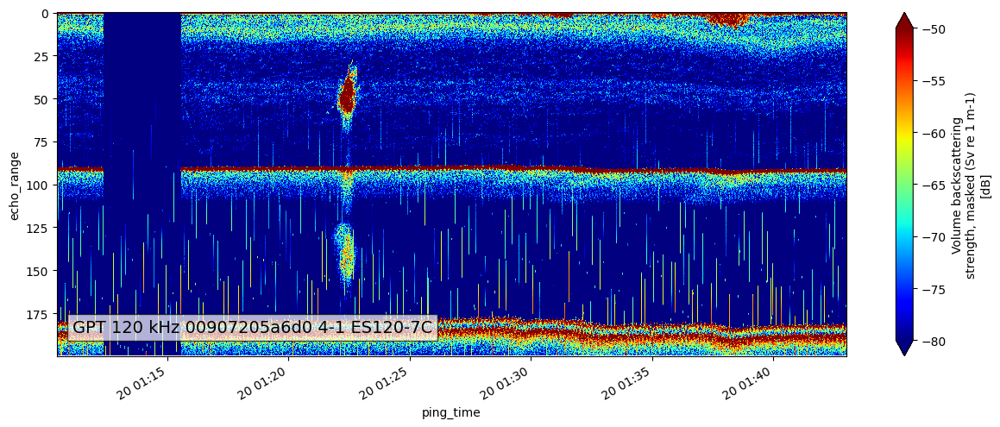

In [39]:
epviz.create_echogram(rapidkrill_ds_no_transient,vmin=-80,vmax=-50)

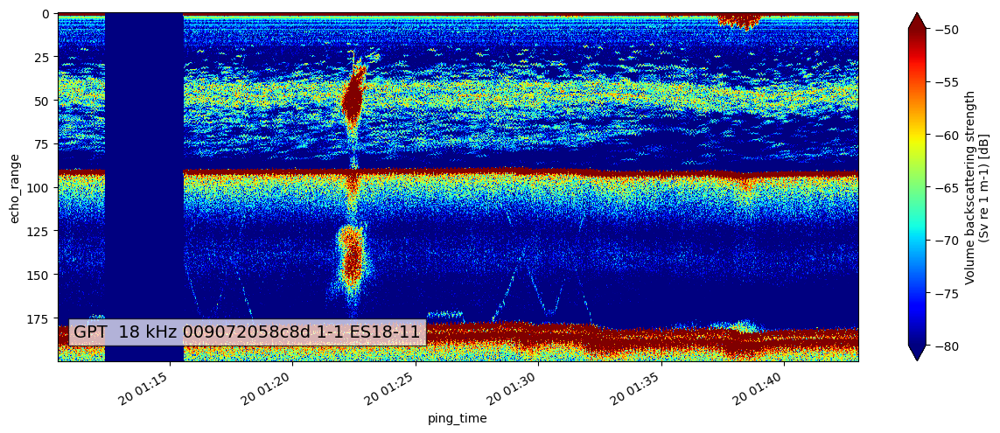

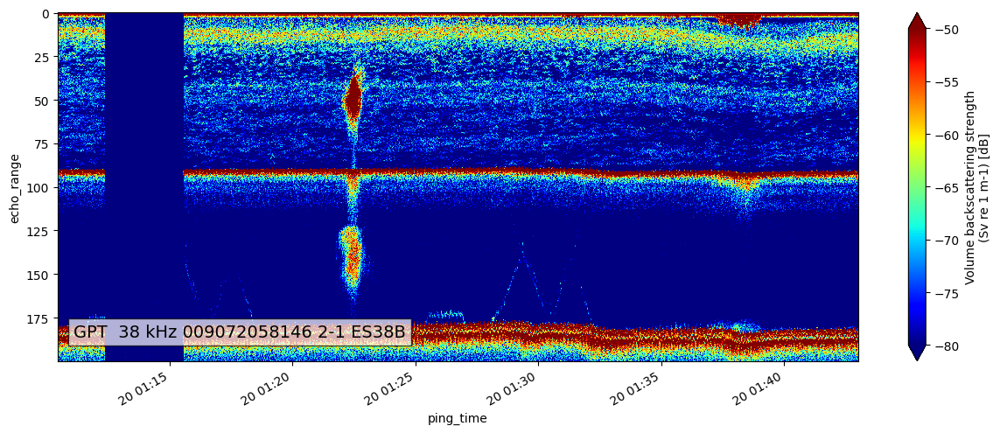

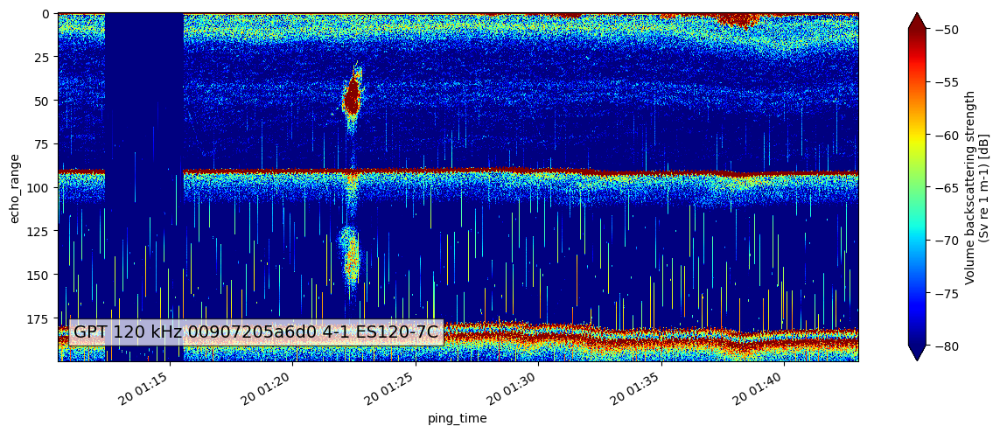

In [40]:
epviz.create_echogram(extended_sv_60_ds,vmin=-80,vmax=-50)

- **Compute noise masks and add them as variables to the dataset (using `create_default_noise_masks_oceanstream` function)**
- Notes:
    - To effectively utilize the `blackwell` method for seabed detection, ensure that the `Sv` dataset includes the `split-beam angle` parameters. Specifically, the input `Sv` dataset should contain both the `angle_alongship` and `angle_athwartship` variables. The absence of these variables will lead to errors. Therefore, `extended_sv_60_ds` must be used.
    - The `create_default_noise_masks_oceanstream` function is designed to generate noise masks and add them to a specific Sv dataset, utilizing default methods set by the oceanstream team for the foundational operations of oceanstream. This feature can be adjusted based on evaluations with various datasets. Within the mask attributes, the function provides insights into the methods employed for each distinct mask type. **Remark:** The function's name might be improved upon, as a seabed mask is not technically a noise mask.

In [41]:
%time
oceanstream_ek60_extended_ds = noise_masks.create_default_noise_masks_oceanstream(extended_sv_60_ds)

CPU times: user 2 µs, sys: 1e+03 ns, total: 3 µs
Wall time: 4.77 µs


In [42]:
oceanstream_ek60_extended_ds

<xarray.Dataset>
Dimensions:                        (channel: 3, ping_time: 1932,
                                    range_sample: 1055, filenames: 1)
Coordinates:
  * channel                        (channel) object 'GPT  18 kHz 009072058c8d...
  * ping_time                      (ping_time) datetime64[ns] 2017-06-20T01:1...
  * range_sample                   (range_sample) int64 0 1 2 ... 1052 1053 1054
  * filenames                      (filenames) int64 0
Data variables: (12/25)
    Sv                             (channel, ping_time, range_sample) float64 ...
    echo_range                     (channel, ping_time, range_sample) float64 ...
    frequency_nominal              (channel) float64 1.8e+04 3.8e+04 1.2e+05
    sound_speed                    (channel, ping_time) float64 1.481e+03 ......
    sound_absorption               (channel, ping_time) float64 0.002822 ... ...
    sa_correction                  (ping_time, channel) float64 -0.83 ... -0.34
    ...                             ...
    angle_alongship                (channel, ping_time, range_sample) float64 ...
    angle_athwartship              (channel, ping_time, range_sample) float64 ...
    mask_transient                 (channel, ping_time, range_sample) bool Tr...
    mask_impulse                   (channel, ping_time, range_sample) bool Tr...
    mask_attenuation               (channel, ping_time, range_sample) bool Fa...
    mask_false_seabed              (channel, ping_time, range_sample) bool Tr...
Attributes:
    processing_software_name:     echopype
    processing_software_version:  0.1.dev2324+gf12819d
    processing_time:              2023-10-12T12:30:10Z
    processing_function:          calibrate.compute_Sv
    processing_level:             Level 2A
    processing_level_url:         https://echopype.readthedocs.io/en/stable/p...

**Enhancement**
- **An upgrade for the future** is the introduction of an **automated mask application system**, allowing users to easily select and integrate their preferred masks into the dataset.

**Background noise**

`Apply only background noise mask`
- applying the background noise mask obtained using the apply_remove_background_noise function

In [43]:
from oceanstream.L2_calibrated_data import background_noise_remover

In [44]:
oceanstream_ds_no_background_noise = background_noise_remover. apply_remove_background_noise(
    oceanstream_ek60_extended_ds
)

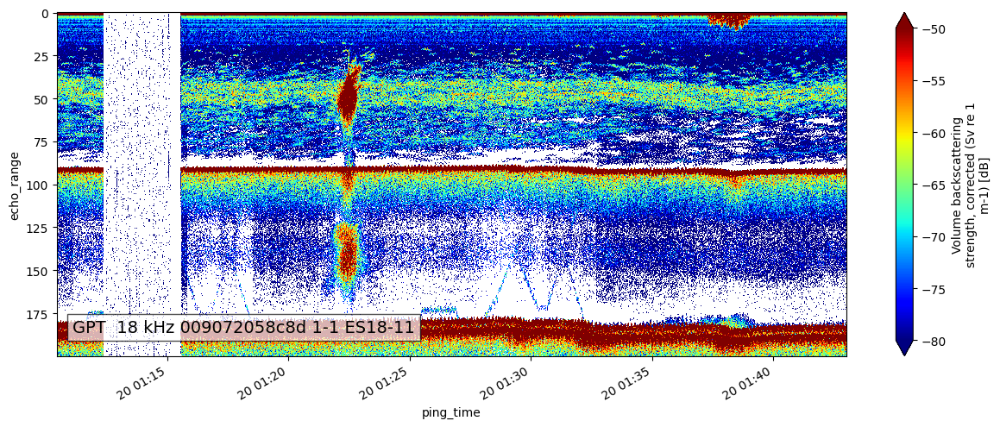

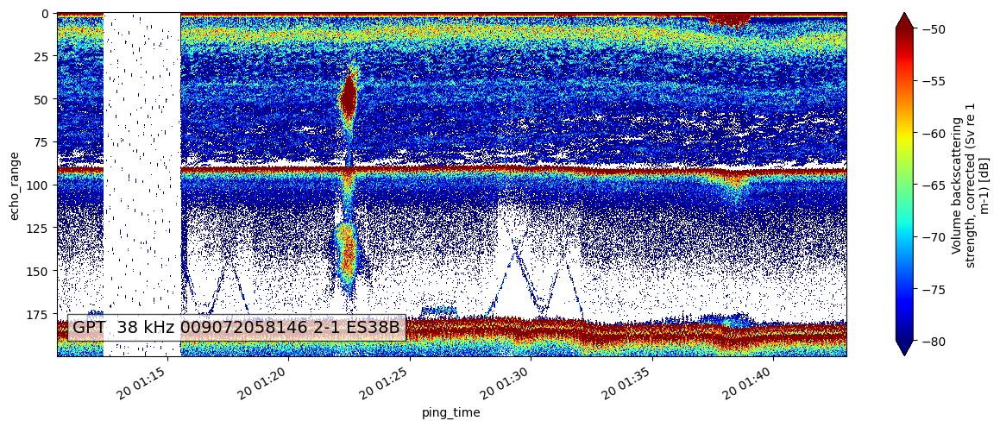

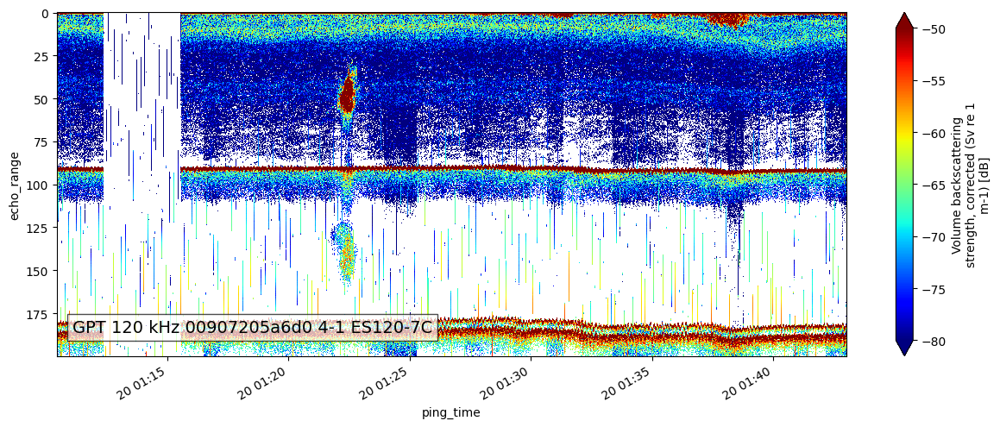

In [45]:
epviz.create_echogram(oceanstream_ds_no_background_noise,vmin=-80,vmax=-50)

**In the next step, the masks are applied to the dataset in the following order:**

1. `Apply impulse noise mask`
    - applying the impulse noise mask obtained using the method from the noise_masks.create_default_noise_masks_oceanstream function,with method=`ryan`

2. `Apply attenuation mask `
    - applying the attenuation mask obtained using the method from the noise_masks.create_default_noise_masks_oceanstream function, with method=`ryan`

3. `Apply transient mask`
    - applying the transient mask obtained using the method from the noise_masks.create_default_noise_masks_oceanstream function, with method=`ryan`

4. `Apply background noise mask`
    - applying the background noise mask obtained using the apply_remove_background_noise function


In [46]:
oceanstream_ds_no_impulse_noise = ep.mask.apply_mask(
    oceanstream_ek60_extended_ds,
    oceanstream_ek60_extended_ds['mask_impulse']
)

oceanstream_ds_no_attenuation = ep.mask.apply_mask(
    oceanstream_ds_no_impulse_noise,
    oceanstream_ek60_extended_ds['mask_attenuation']
)



oceanstream_ds_no_transient = ep.mask.apply_mask(
    oceanstream_ds_no_attenuation,
    oceanstream_ek60_extended_ds['mask_transient']
)


ds_no_background_noise = background_noise_remover.apply_remove_background_noise(oceanstream_ds_no_transient)

cleaned_ds = ds_no_background_noise

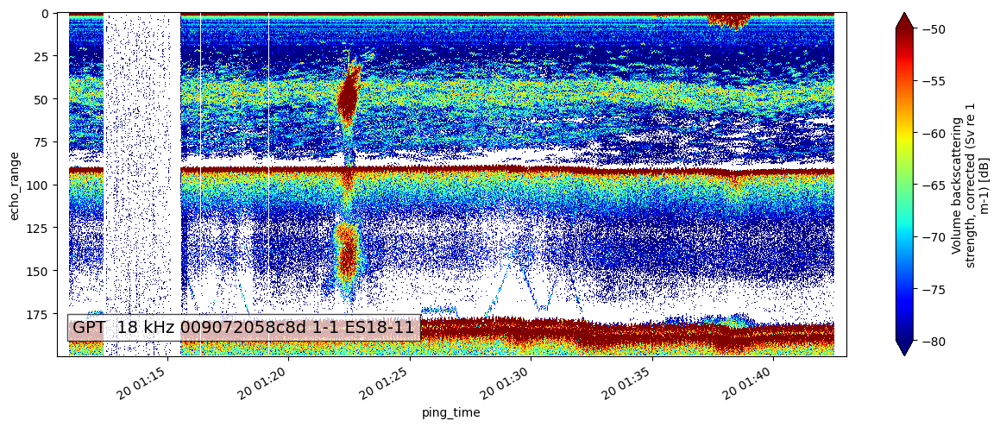

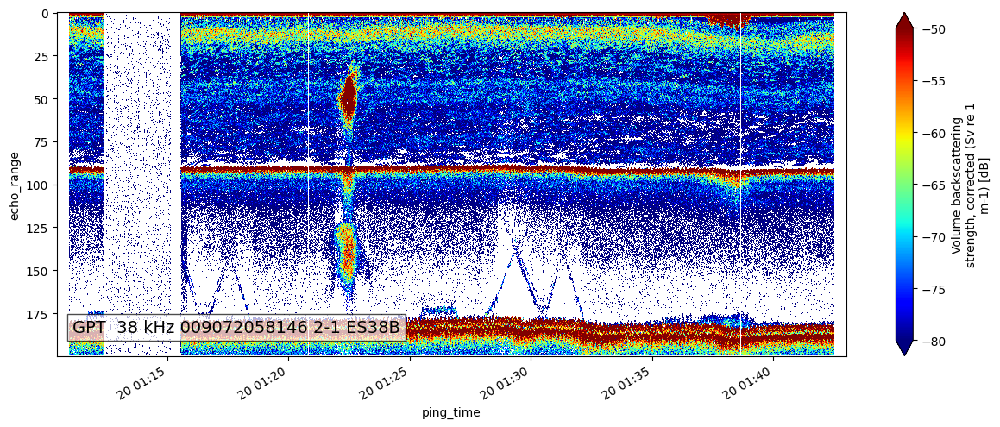

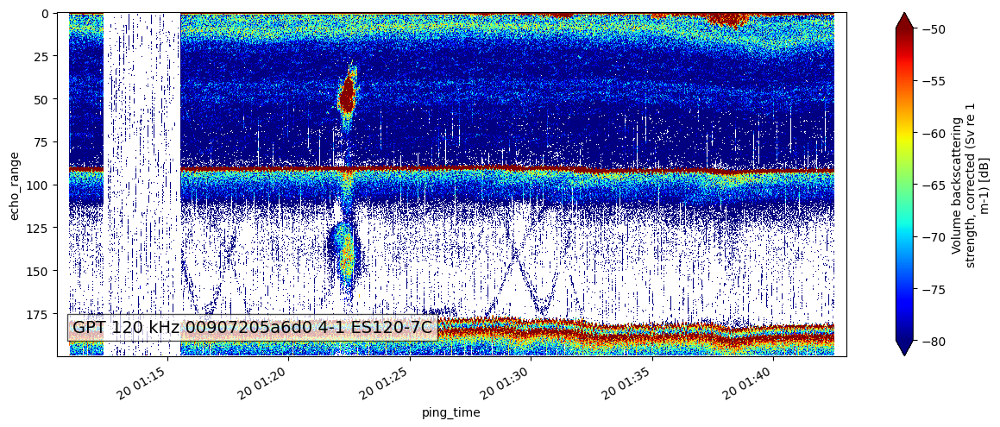

In [47]:
epviz.create_echogram(cleaned_ds,vmin=-80,vmax=-50)

**Save noise free EK60 dataset**

In [48]:
from oceanstream.L2_calibrated_data import processed_data_io
processed_data_io.write_processed(
    sv = cleaned_ds,
    file_path = L2_tour_data_path,
    file_name = "noise_free_EK60",
    file_type = "nc",
)


### Sv interpolation

In [49]:
from oceanstream.L2_calibrated_data import sv_interpolation

In [50]:
interpolated_ds = sv_interpolation.interpolate_sv(cleaned_ds)
interpolated_ds

<xarray.Dataset>
Dimensions:                        (channel: 3, ping_time: 1932,
                                    range_sample: 1055, filenames: 1)
Coordinates:
  * channel                        (channel) <U37 'GPT  18 kHz 009072058c8d 1...
  * ping_time                      (ping_time) datetime64[ns] 2017-06-20T01:1...
  * range_sample                   (range_sample) int64 0 1 2 ... 1052 1053 1054
  * filenames                      (filenames) int64 0
Data variables: (12/28)
    Sv_with_background_noise       (channel, ping_time, range_sample) float64 ...
    echo_range                     (channel, ping_time, range_sample) float64 ...
    frequency_nominal              (channel) float64 1.8e+04 3.8e+04 1.2e+05
    sound_speed                    (channel, ping_time) float64 1.481e+03 ......
    sound_absorption               (channel, ping_time) float64 0.002822 ... ...
    sa_correction                  (ping_time, channel) float64 -0.83 ... -0.34
    ...                             ...
    mask_impulse                   (channel, ping_time, range_sample) bool Tr...
    mask_attenuation               (channel, ping_time, range_sample) bool Fa...
    mask_false_seabed              (channel, ping_time, range_sample) bool Tr...
    Sv_noise                       (channel, ping_time, range_sample) float64 ...
    Sv                             (channel, ping_time, range_sample) float64 ...
    Sv_interpolated                (channel, ping_time, range_sample) float64 ...
Attributes:
    processing_software_name:     echopype
    processing_software_version:  0.1.dev2324+gf12819d
    processing_time:              2023-10-12T12:33:51Z
    processing_function:          clean.remove_noise
    processing_level:             Level 3B
    processing_level_url:         https://echopype.readthedocs.io/en/stable/p...
    mask_software_name:           echopype
    mask_software_version:        0.1.dev2324+gf12819d
    mask_time:                    2023-10-12T12:33:50Z
    mask_function:                mask.apply_mask

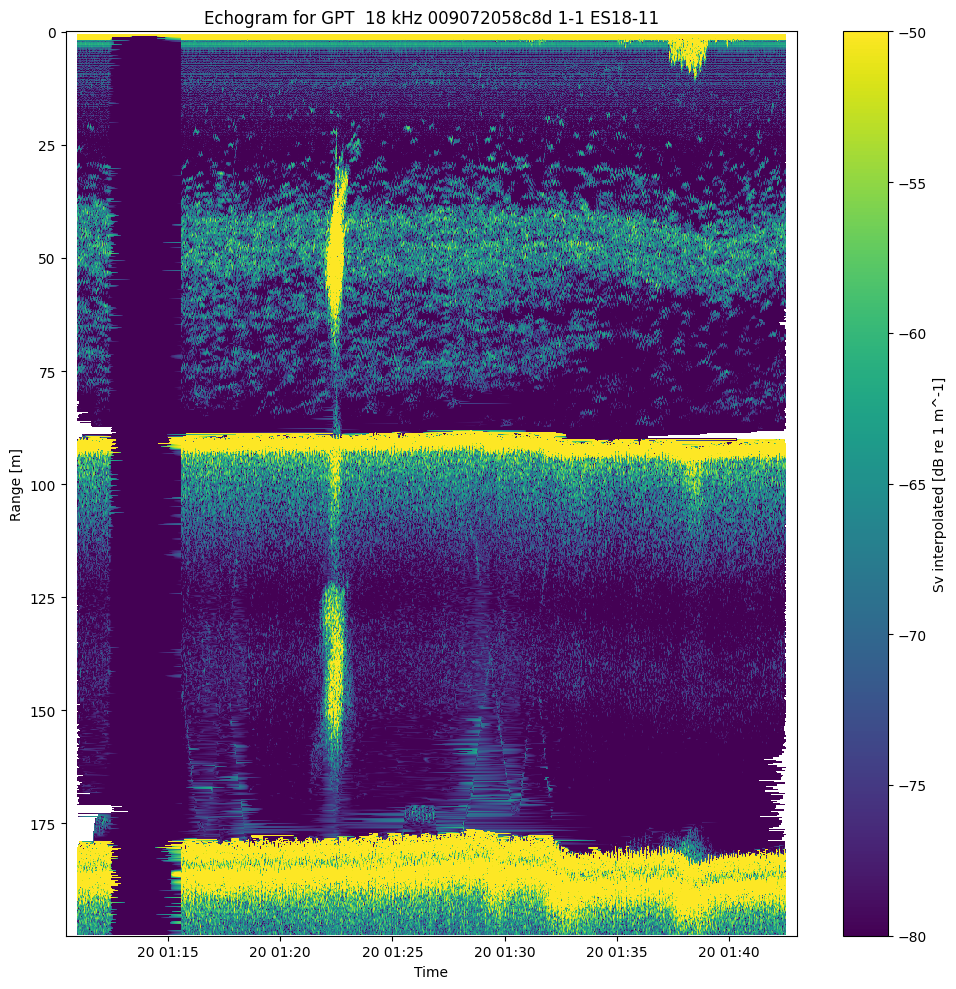

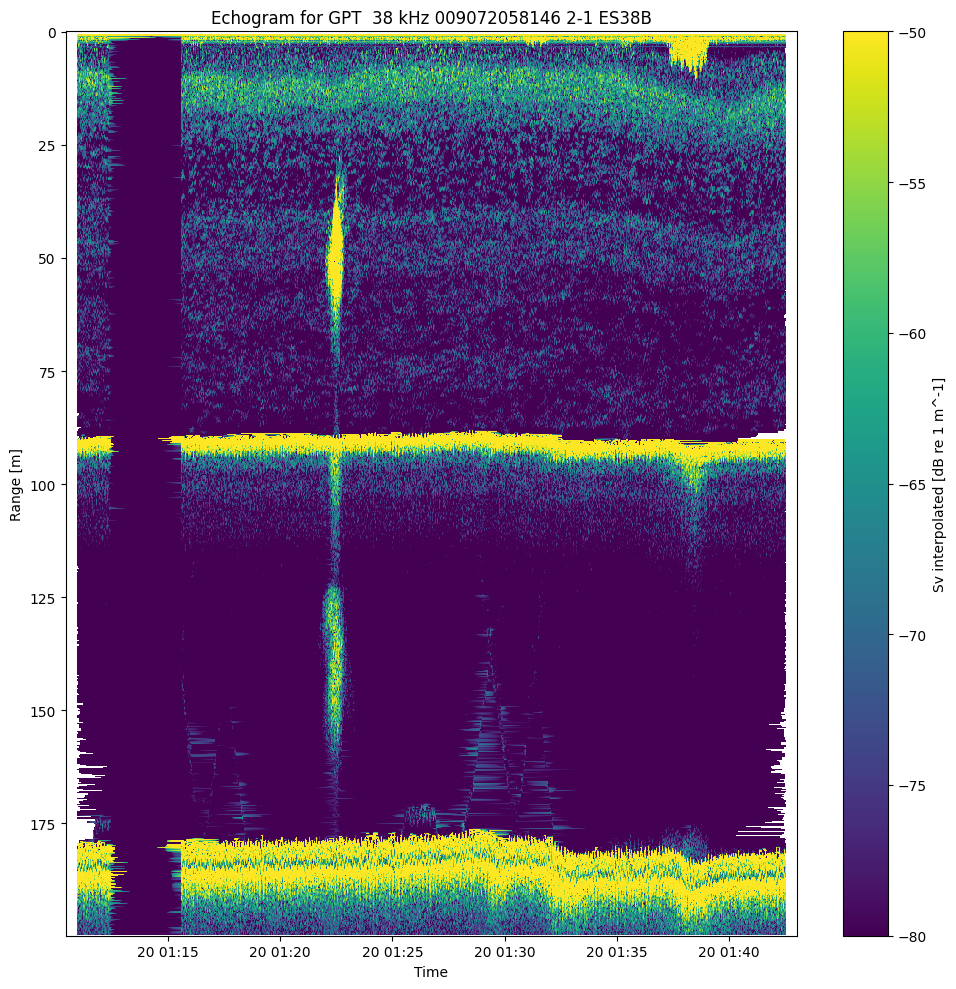

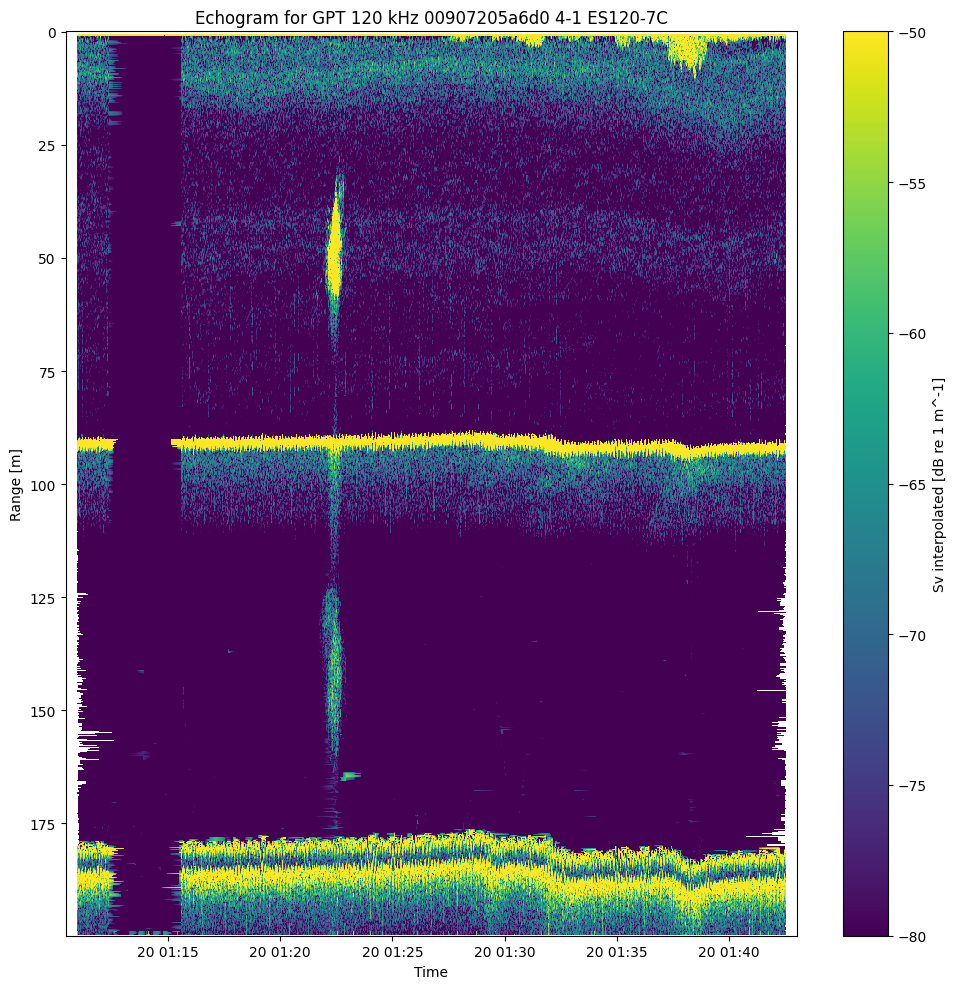

In [51]:
import matplotlib.pyplot as plt

# Select the data from the desired channel
desired_channel = 'GPT  18 kHz 009072058c8d 1-1 ES18-11'
Sv = interpolated_ds['Sv_interpolated'].sel(channel=desired_channel)
ping_time = interpolated_ds['ping_time']
range_sample = interpolated_ds['echo_range'].sel(channel=desired_channel)

# Create the echogram
plt.figure(figsize=(10,10))
plt.pcolormesh(ping_time, range_sample.T, Sv.T, cmap='viridis', vmin=-80, vmax=-50)
plt.gca().invert_yaxis()
plt.colorbar(label='Sv interpolated [dB re 1 m^-1]')
plt.ylabel('Range [m]')
plt.xlabel('Time')
plt.title(f'Echogram for {desired_channel}')
plt.tight_layout()
plt.show()

# Select the data from the desired channel
desired_channel = 'GPT  38 kHz 009072058146 2-1 ES38B'
Sv = interpolated_ds['Sv_interpolated'].sel(channel=desired_channel)
ping_time = interpolated_ds['ping_time']
range_sample = interpolated_ds['echo_range'].sel(channel=desired_channel)

# Create the echogram
plt.figure(figsize=(10,10))
plt.pcolormesh(ping_time, range_sample.T, Sv.T, cmap='viridis', vmin=-80, vmax=-50)
plt.gca().invert_yaxis()
plt.colorbar(label='Sv interpolated [dB re 1 m^-1]')
plt.ylabel('Range [m]')
plt.xlabel('Time')
plt.title(f'Echogram for {desired_channel}')
plt.tight_layout()
plt.show()

# Select the data from the desired channel
desired_channel = 'GPT 120 kHz 00907205a6d0 4-1 ES120-7C'
Sv = interpolated_ds['Sv_interpolated'].sel(channel=desired_channel)
ping_time = interpolated_ds['ping_time']
range_sample = interpolated_ds['echo_range'].sel(channel=desired_channel)

# Create the echogram
plt.figure(figsize=(10,10))
plt.pcolormesh(ping_time, range_sample.T, Sv.T, cmap='viridis', vmin=-80, vmax=-50)
plt.gca().invert_yaxis()
plt.colorbar(label='Sv interpolated [dB re 1 m^-1]')
plt.ylabel('Range [m]')
plt.xlabel('Time')
plt.title(f'Echogram for {desired_channel}')
plt.tight_layout()
plt.show()

**EK80 - Noise masks**

In [52]:
# %time
# rapidkrill_ek80_extended_ds = noise_masks.create_noise_masks_rapidkrill(extended_sv_80_ds)

In [53]:
%time
oceanstream_ek80_extended_ds = noise_masks.create_default_noise_masks_oceanstream(extended_sv_80_ds)

CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 5.96 µs


/Users/simedroniraluca/Documents/pineview/oceanstream/.venv/lib/python3.9/site-packages/echopype/utils/mask_transformation.py:285: RuntimeWarning: invalid value encountered in divide
  datar[i, :] = np.nansum(d * w_, axis=0) / np.nansum(w_, axis=0)


In [54]:
oceanstream_ek80_extended_ds

<xarray.Dataset>
Dimensions:                        (channel: 5, ping_time: 13,
                                    range_sample: 123897, filenames: 1)
Coordinates:
  * channel                        (channel) object 'WBT 545604-15 ES38B' ......
  * ping_time                      (ping_time) datetime64[ns] 2016-11-09T16:3...
  * range_sample                   (range_sample) int64 0 1 2 ... 123895 123896
  * filenames                      (filenames) int64 0
Data variables: (12/31)
    Sv                             (channel, ping_time, range_sample) float64 ...
    echo_range                     (channel, ping_time, range_sample) float64 ...
    frequency_nominal              (channel) float64 3.8e+04 1.8e+04 ... 7e+04
    sound_speed                    float64 1.514e+03
    sound_absorption               (channel) float64 0.007929 ... 0.01852
    temperature                    float64 10.0
    ...                             ...
    angle_alongship                (channel, ping_time, range_sample) float64 ...
    angle_athwartship              (channel, ping_time, range_sample) float64 ...
    mask_transient                 (channel, ping_time, range_sample) bool Tr...
    mask_impulse                   (channel, ping_time, range_sample) bool Fa...
    mask_attenuation               (channel, ping_time, range_sample) bool Fa...
    mask_false_seabed              (channel, ping_time, range_sample) bool Tr...
Attributes:
    processing_software_name:     echopype
    processing_software_version:  0.1.dev2324+gf12819d
    processing_time:              2023-10-12T12:30:13Z
    processing_function:          calibrate.compute_Sv

In [55]:
processed_data_io.write_processed(
    sv = oceanstream_ek80_extended_ds,
    file_path = L2_tour_data_path,
    file_name = "extended_ds_EK80",
    file_type = "nc",
)

In [56]:
processed_data_io.write_processed(
    sv = oceanstream_ek80_extended_ds,
    file_path = L2_tour_data_path,
    file_name = "extended_ds_EK80",
    file_type = "zarr",
)

**In the next step, the masks are applied to the dataset in the following order:**

1. `Apply impulse noise mask`
    - applying the impulse noise mask obtained using the method from the noise_masks.create_default_noise_masks_oceanstream function,with method=`ryan`

2. `Apply attenuation mask `
    - applying the attenuation mask obtained using the method from the noise_masks.create_default_noise_masks_oceanstream function, with method=`ryan`

3. `Apply transient mask`
    - applying the transient mask obtained using the method from the noise_masks.create_default_noise_masks_oceanstream function, with method=`ryan`

4. `Apply background noise mask`
    - applying the background noise mask obtained using the apply_remove_background_noise function

In [57]:
oceanstream_ds_no_impulse_noise = ep.mask.apply_mask(
    oceanstream_ek80_extended_ds,
    oceanstream_ek80_extended_ds['mask_impulse']
)

oceanstream_ds_no_attenuation = ep.mask.apply_mask(
    oceanstream_ds_no_impulse_noise,
    oceanstream_ek80_extended_ds['mask_attenuation']
)



oceanstream_ds_no_transient = ep.mask.apply_mask(
    oceanstream_ds_no_attenuation,
    oceanstream_ek80_extended_ds['mask_transient']
)


ds_no_background_noise = background_noise_remover.apply_remove_background_noise(oceanstream_ds_no_transient)

cleaned_ds = ds_no_background_noise

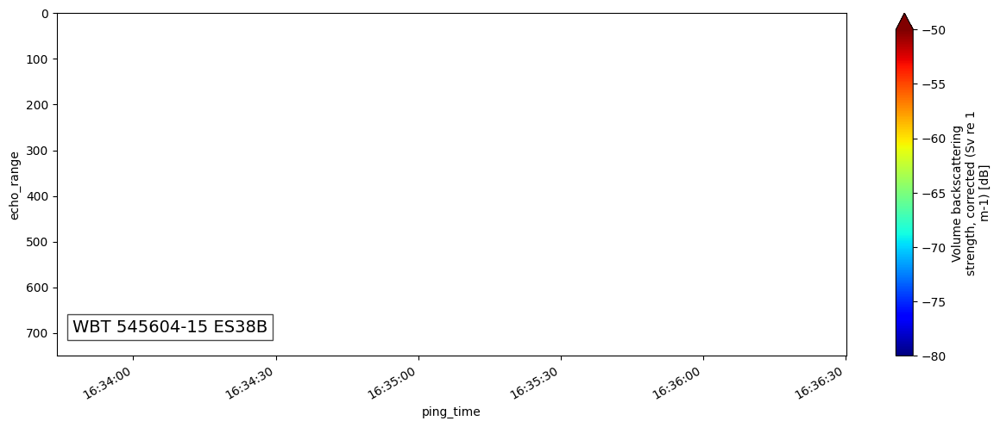

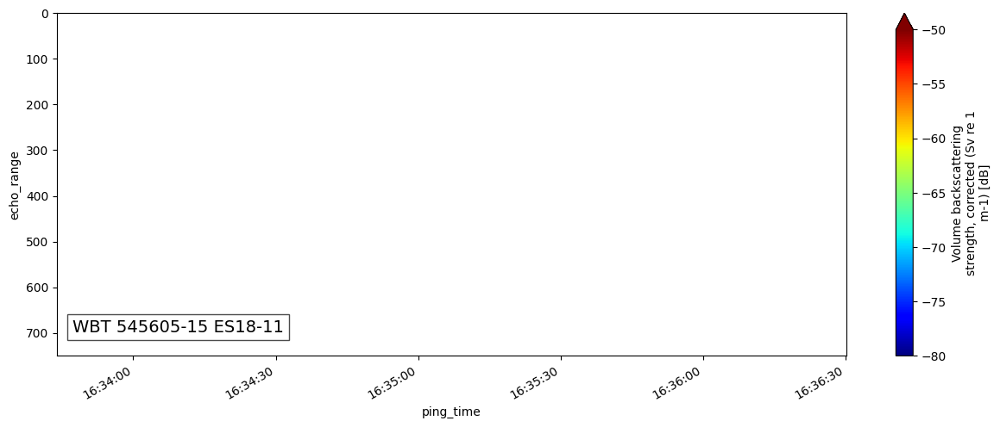

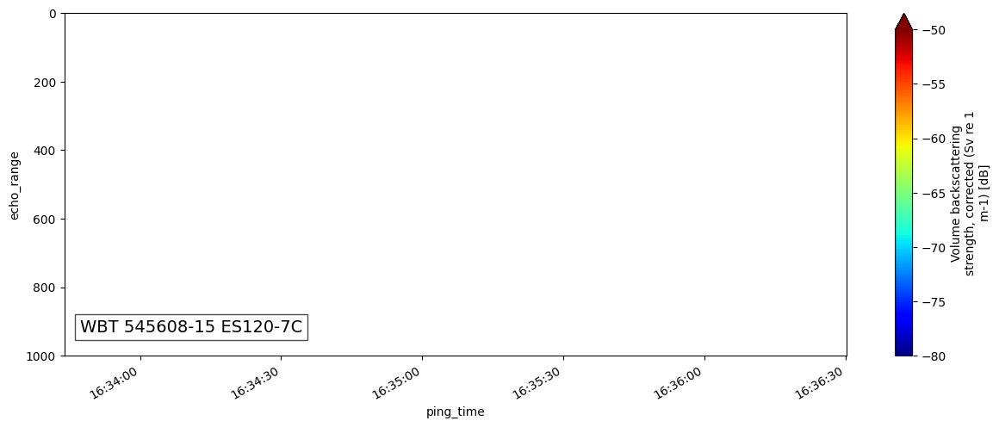

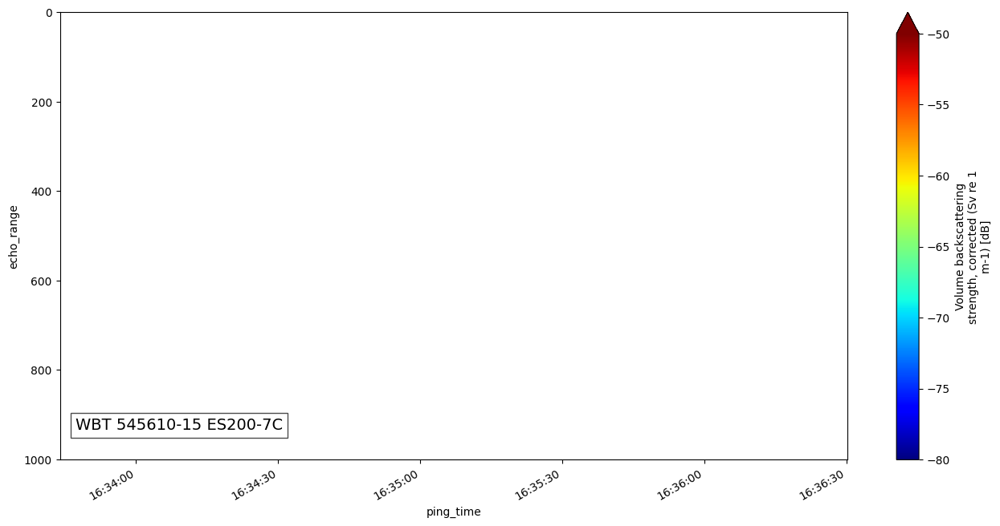

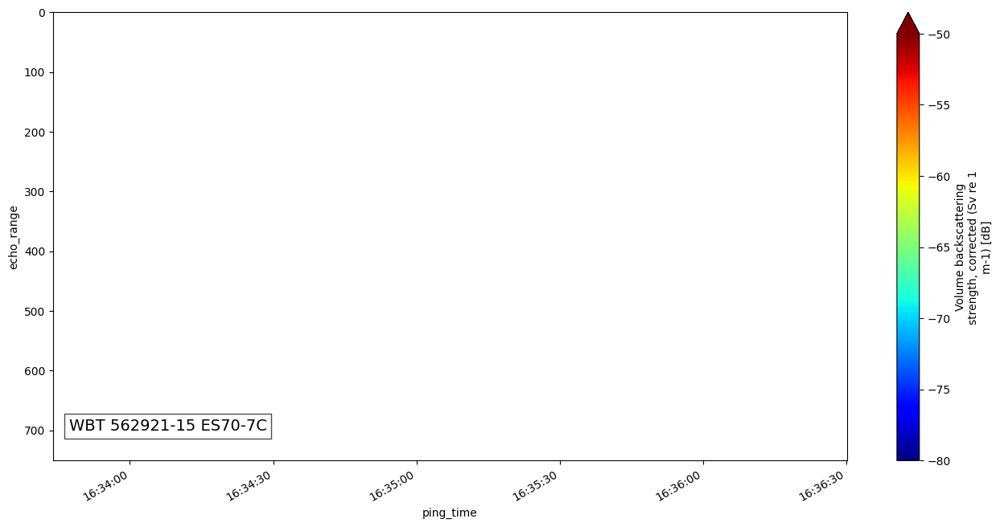

In [58]:
selected_channels = cleaned_ds.sel(channel=['WBT 545604-15 ES38B', 'WBT 545605-15 ES18-11', 'WBT 545608-15 ES120-7C'])
epviz.create_echogram(selected_channels,vmin=-80,vmax=-50)
selected_channels = cleaned_ds.sel(channel=['WBT 545610-15 ES200-7C', 'WBT 562921-15 ES70-7C'])
epviz.create_echogram(selected_channels,vmin=-80,vmax=-50)

**Remark:** 
- For the EK80 Sv dataset, when all types of noise masks and background noise are applied, the useful signal seems to be entirely classified as noise. Therefore, in the subsequent step, only background noise removal is applied.

In [59]:
ds_just_no_background_noise = background_noise_remover.apply_remove_background_noise(oceanstream_ek80_extended_ds)

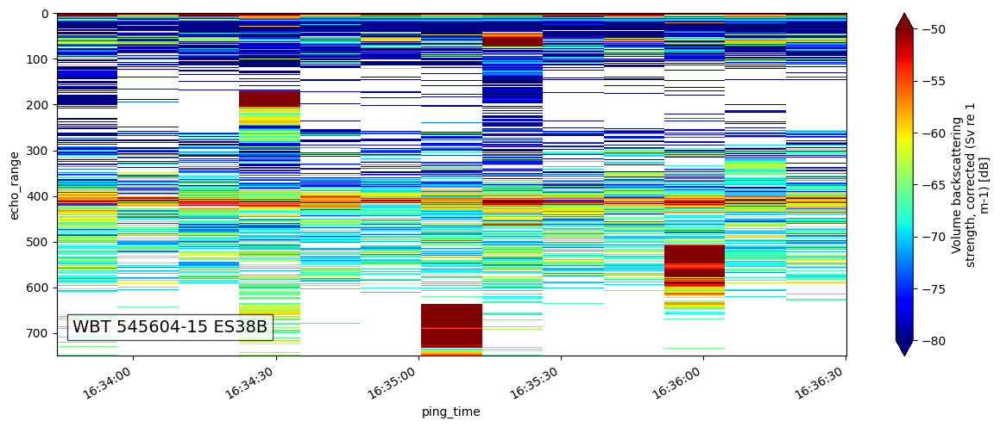

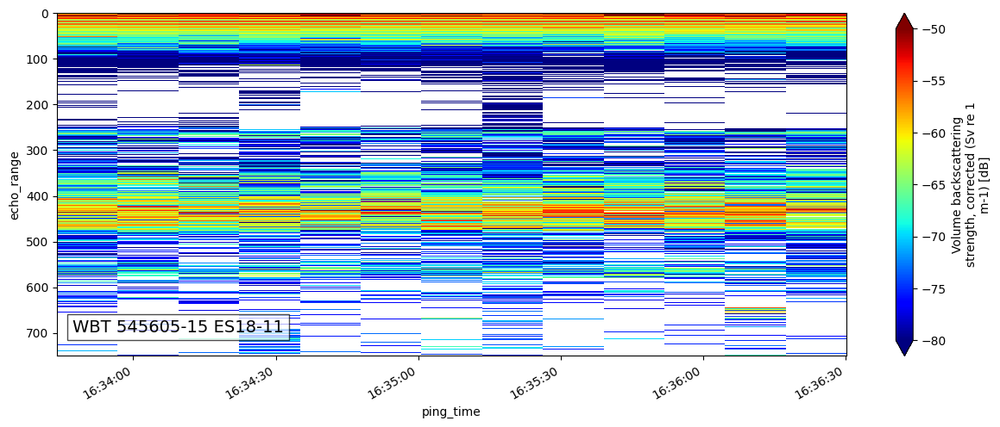

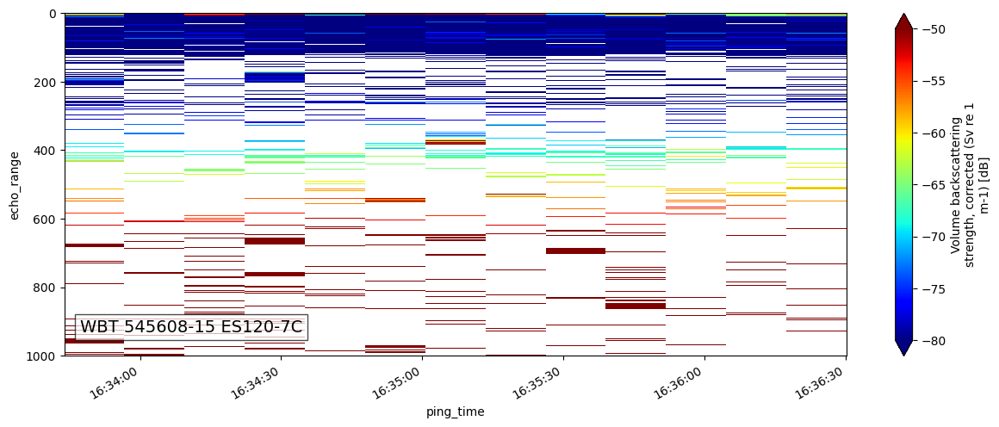

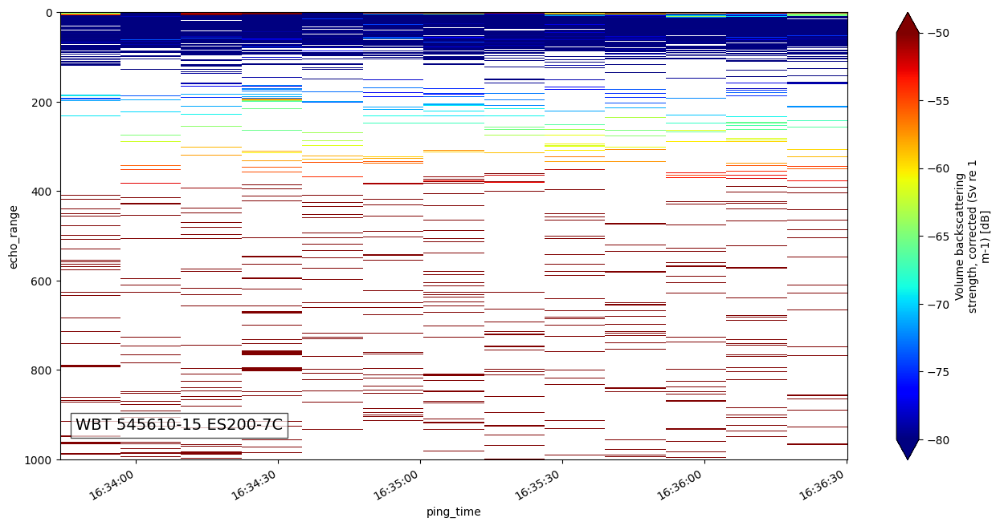

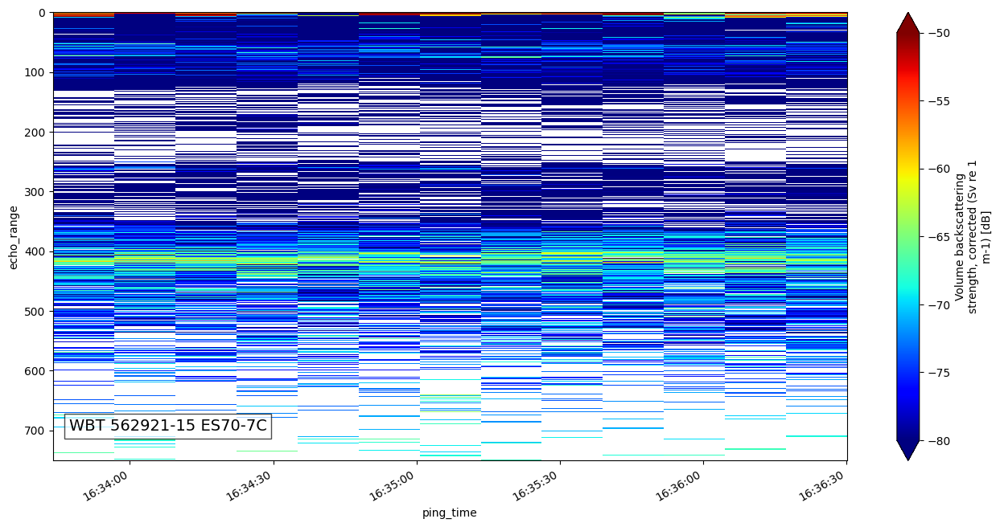

In [60]:
selected_channels = ds_just_no_background_noise.sel(channel=['WBT 545604-15 ES38B', 
                                                             'WBT 545605-15 ES18-11', 
                                                             'WBT 545608-15 ES120-7C']
                                                   )
epviz.create_echogram(selected_channels,vmin=-80,vmax=-50)
selected_channels = ds_just_no_background_noise.sel(channel=['WBT 545610-15 ES200-7C', 'WBT 562921-15 ES70-7C'])
epviz.create_echogram(selected_channels,vmin=-80,vmax=-50)

### Bugs

**Plot the datasets to ensure they remain unaffected by the previous processing.**

In [61]:
oceanstream_ek80_extended_ds

<xarray.Dataset>
Dimensions:                        (channel: 5, ping_time: 13,
                                    range_sample: 123897, filenames: 1)
Coordinates:
  * channel                        (channel) object 'WBT 545604-15 ES38B' ......
  * ping_time                      (ping_time) datetime64[ns] 2016-11-09T16:3...
  * range_sample                   (range_sample) int64 0 1 2 ... 123895 123896
  * filenames                      (filenames) int64 0
Data variables: (12/31)
    Sv                             (channel, ping_time, range_sample) float64 ...
    echo_range                     (channel, ping_time, range_sample) float64 ...
    frequency_nominal              (channel) float64 3.8e+04 1.8e+04 ... 7e+04
    sound_speed                    float64 1.514e+03
    sound_absorption               (channel) float64 0.007929 ... 0.01852
    temperature                    float64 10.0
    ...                             ...
    angle_alongship                (channel, ping_time, range_sample) float64 ...
    angle_athwartship              (channel, ping_time, range_sample) float64 ...
    mask_transient                 (channel, ping_time, range_sample) bool Tr...
    mask_impulse                   (channel, ping_time, range_sample) bool Fa...
    mask_attenuation               (channel, ping_time, range_sample) bool Fa...
    mask_false_seabed              (channel, ping_time, range_sample) bool Tr...
Attributes:
    processing_software_name:     echopype
    processing_software_version:  0.1.dev2324+gf12819d
    processing_time:              2023-10-12T12:30:13Z
    processing_function:          calibrate.compute_Sv

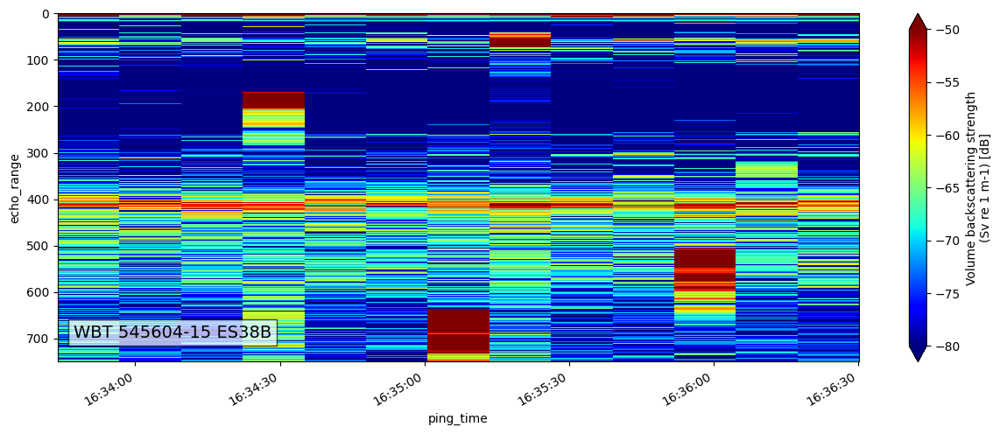

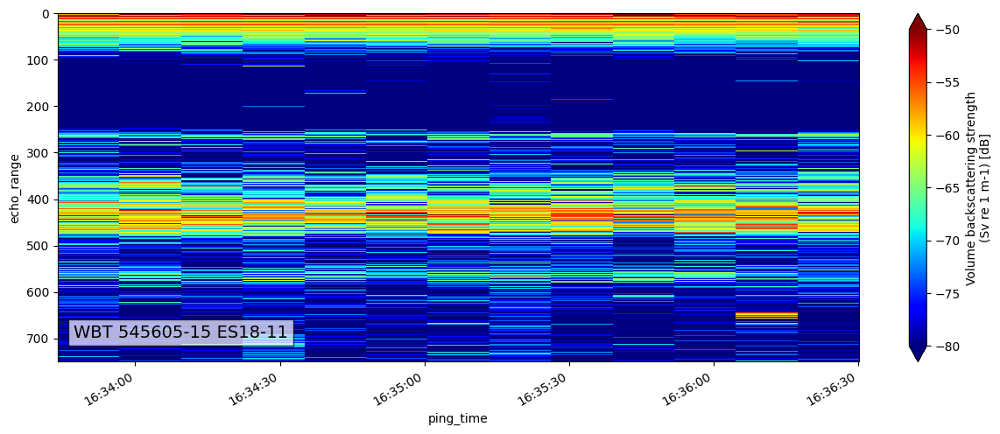

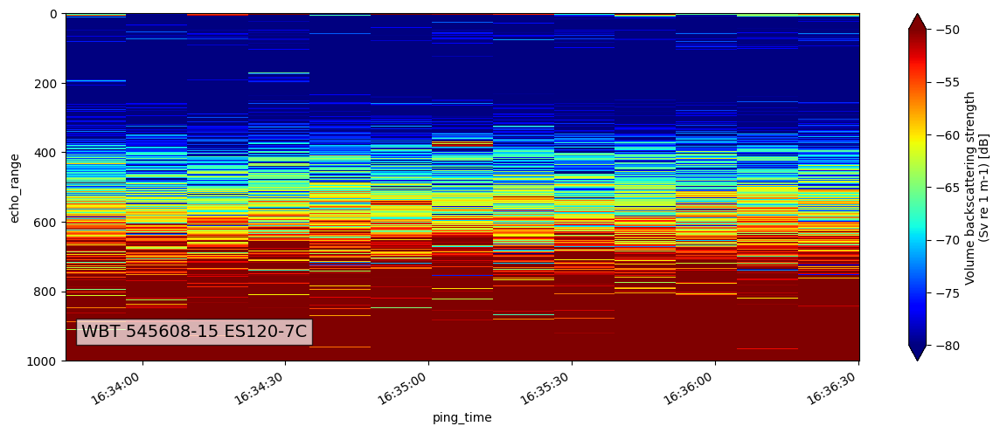

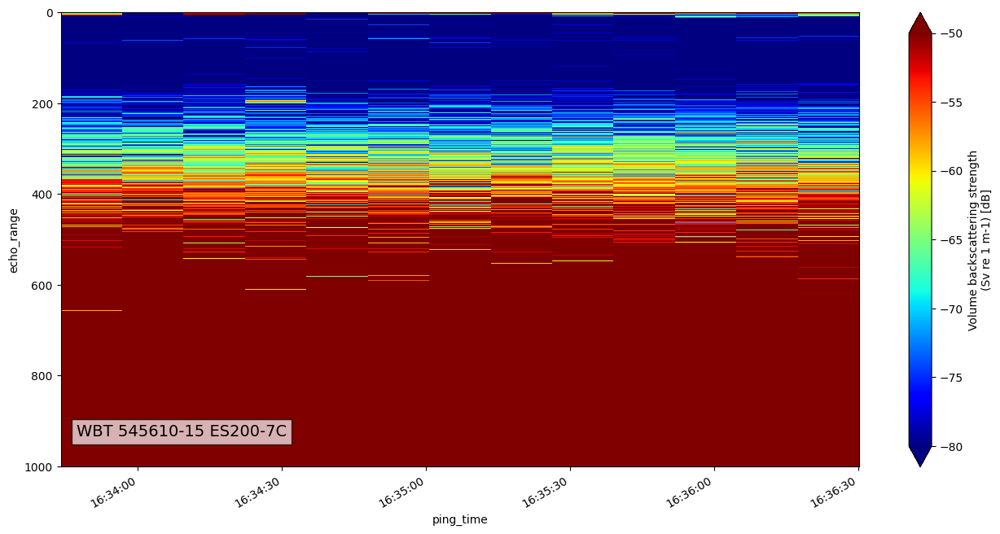

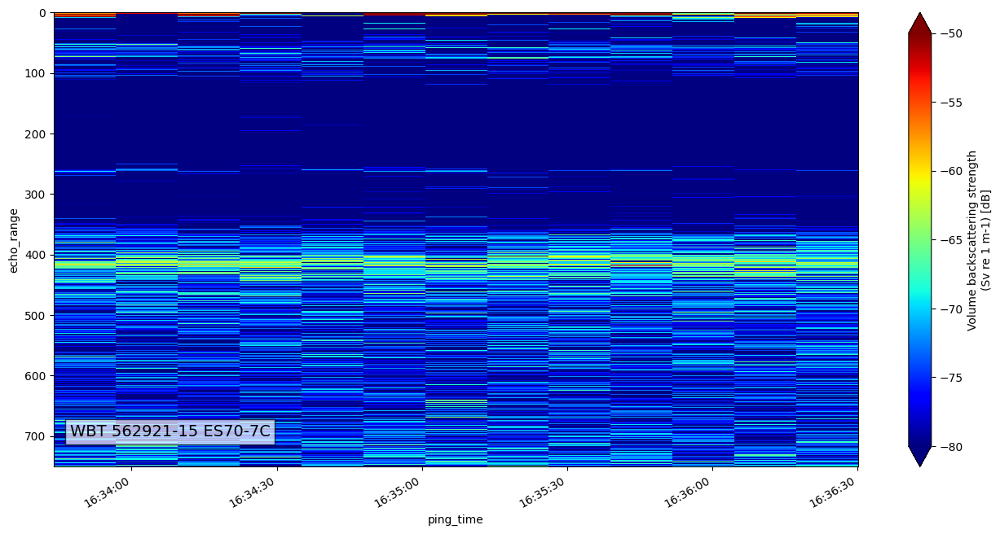

In [62]:
selected_channels = oceanstream_ek80_extended_ds.sel(channel=['WBT 545604-15 ES38B', 'WBT 545605-15 ES18-11', 'WBT 545608-15 ES120-7C'])
epviz.create_echogram(selected_channels,vmin=-80,vmax=-50)
selected_channels = oceanstream_ek80_extended_ds.sel(channel=['WBT 545610-15 ES200-7C', 'WBT 562921-15 ES70-7C'])
epviz.create_echogram(selected_channels,vmin=-80,vmax=-50)

In [63]:
oceanstream_ek60_extended_ds

<xarray.Dataset>
Dimensions:                        (channel: 3, ping_time: 1932,
                                    range_sample: 1055, filenames: 1)
Coordinates:
  * channel                        (channel) object 'GPT  18 kHz 009072058c8d...
  * ping_time                      (ping_time) datetime64[ns] 2017-06-20T01:1...
  * range_sample                   (range_sample) int64 0 1 2 ... 1052 1053 1054
  * filenames                      (filenames) int64 0
Data variables: (12/25)
    Sv                             (channel, ping_time, range_sample) float64 ...
    echo_range                     (channel, ping_time, range_sample) float64 ...
    frequency_nominal              (channel) float64 1.8e+04 3.8e+04 1.2e+05
    sound_speed                    (channel, ping_time) float64 1.481e+03 ......
    sound_absorption               (channel, ping_time) float64 0.002822 ... ...
    sa_correction                  (ping_time, channel) float64 -0.83 ... -0.34
    ...                             ...
    angle_alongship                (channel, ping_time, range_sample) float64 ...
    angle_athwartship              (channel, ping_time, range_sample) float64 ...
    mask_transient                 (channel, ping_time, range_sample) bool Tr...
    mask_impulse                   (channel, ping_time, range_sample) bool Tr...
    mask_attenuation               (channel, ping_time, range_sample) bool Fa...
    mask_false_seabed              (channel, ping_time, range_sample) bool Tr...
Attributes:
    processing_software_name:     echopype
    processing_software_version:  0.1.dev2324+gf12819d
    processing_time:              2023-10-12T12:30:10Z
    processing_function:          calibrate.compute_Sv
    processing_level:             Level 2A
    processing_level_url:         https://echopype.readthedocs.io/en/stable/p...

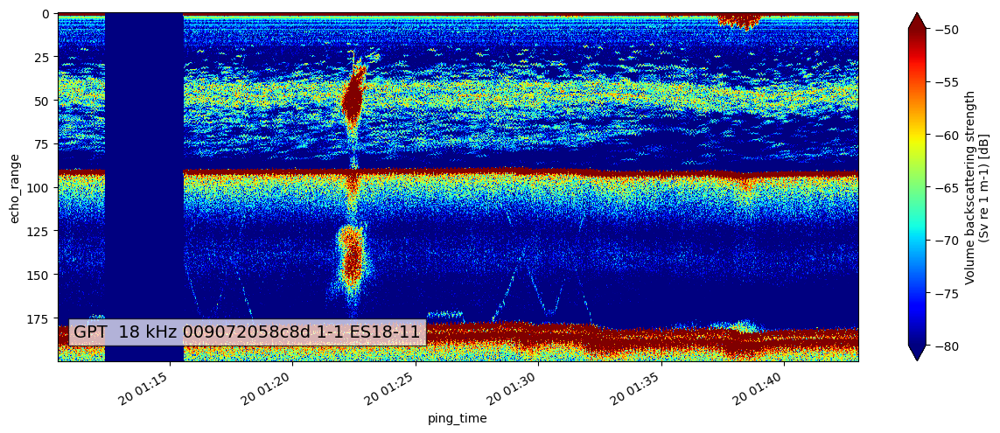

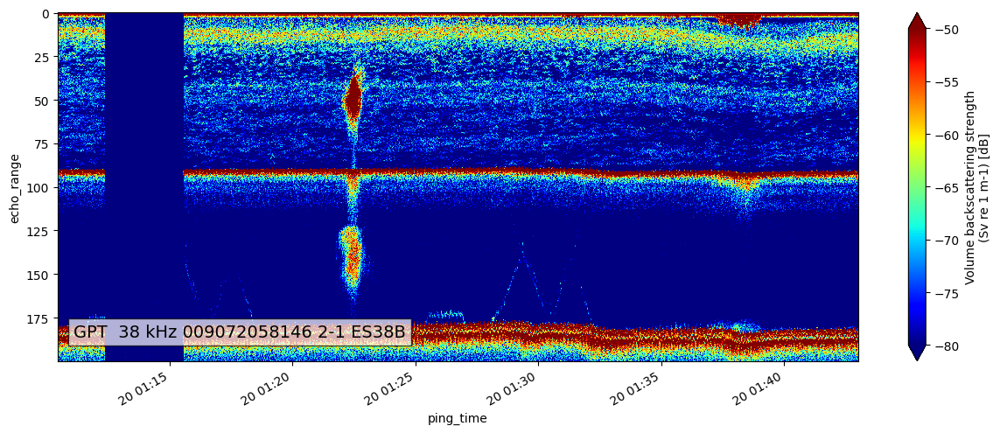

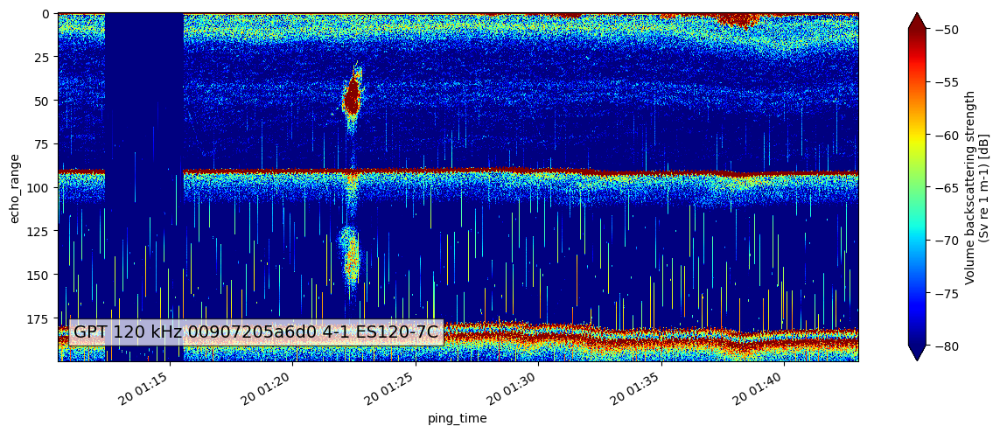

In [64]:
epviz.create_echogram(oceanstream_ek60_extended_ds,vmin=-80,vmax=-50)

In [65]:
FIELDING_DEFAULT_PARAMS = {
    "r0": 200,
    "r1": 1000,
    "n": 5,
    "thr": [2, 0],
    "roff": 250,
    "jumps": 5,
    "maxts": -35,
    "start": 0,
}
oceanstream_ek60_mask_fielding = noise_masks.create_transient_mask(
    oceanstream_ek60_extended_ds, parameters=FIELDING_DEFAULT_PARAMS, method="fielding"
)

AttributeError: 'tuple' object has no attribute 'coords'

In [66]:
FIELDING_DEFAULT_PARAMS = {
    "r0": 200,
    "r1": 1000,
    "n": 5,
    "thr": [2, 0],
    "roff": 250,
    "jumps": 5,
    "maxts": -35,
    "start": 0,
}
oceanstream_ek80_mask_fielding = noise_masks.create_transient_mask(
    oceanstream_ek80_extended_ds, parameters=FIELDING_DEFAULT_PARAMS, method="fielding"
)

/Users/simedroniraluca/Documents/pineview/oceanstream/.venv/lib/python3.9/site-packages/echopype/clean/transient_noise.py:224: RuntimeWarning: All-NaN slice encountered
  pingmedian = _log(np.nanmedian(_lin(Sv[j, r0:r1])))
/Users/simedroniraluca/Documents/pineview/oceanstream/.venv/lib/python3.9/site-packages/echopype/clean/transient_noise.py:225: RuntimeWarning: All-NaN slice encountered
  blockmedian = _log(np.nanmedian(_lin(Sv[j - n : j + n, r0:r1])))


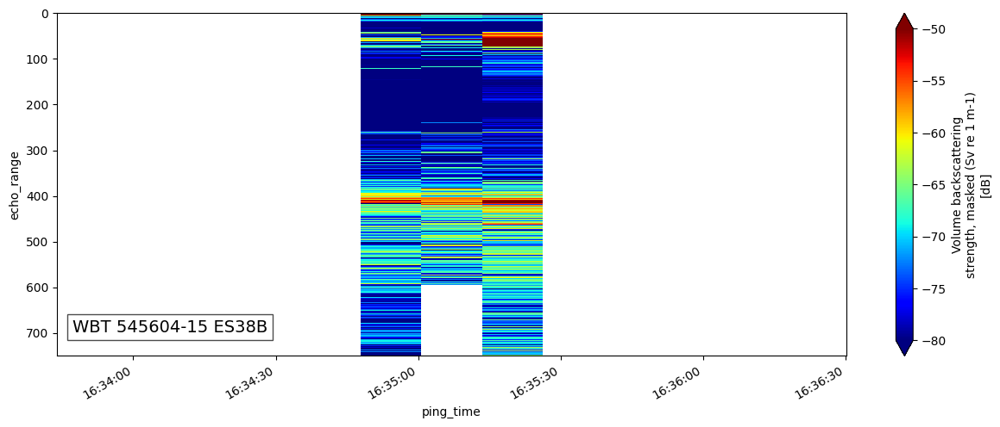

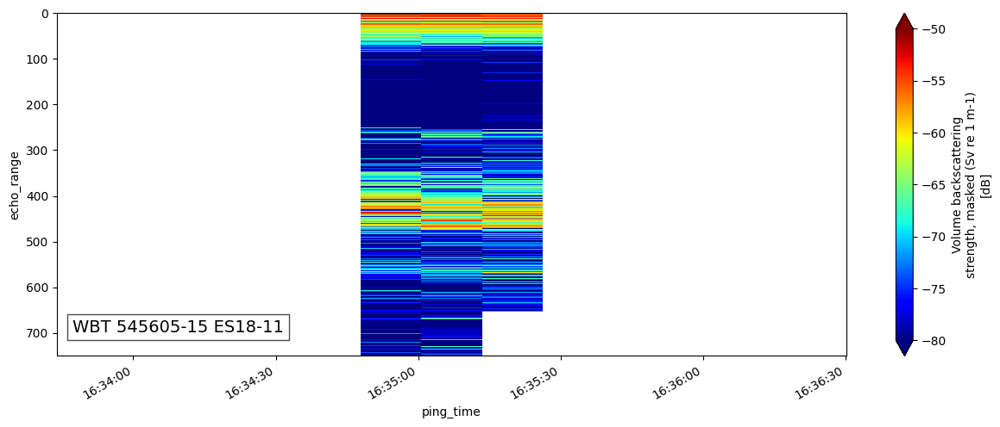

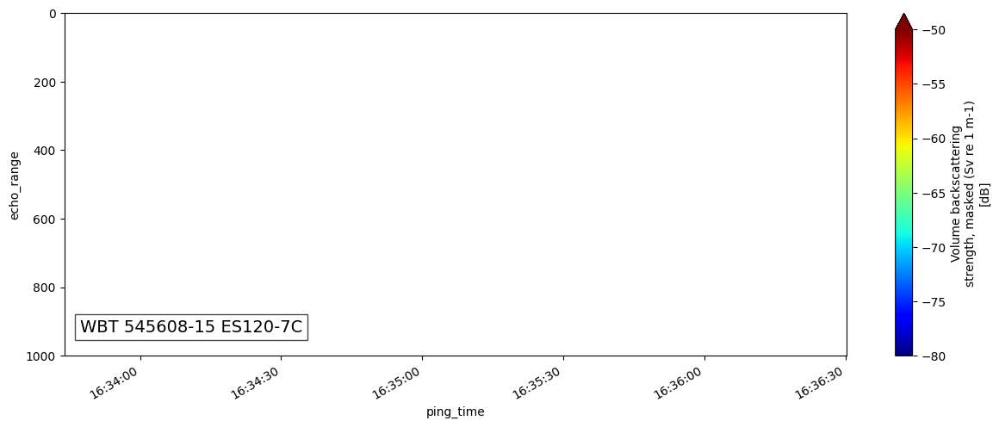

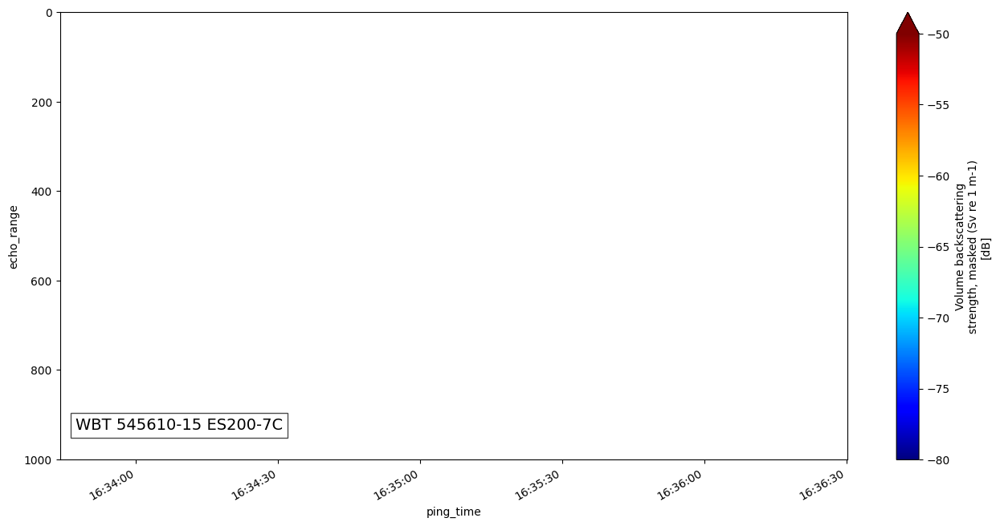

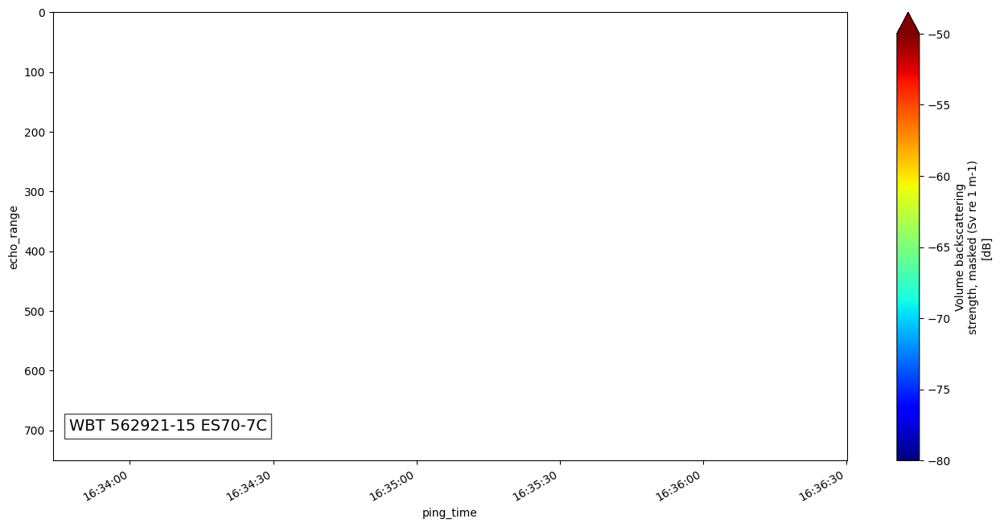

In [67]:
oceanstream_ek80_fielding_ds = ep.mask.apply_mask(oceanstream_ek80_extended_ds, oceanstream_ek80_mask_fielding)
selected_channels = oceanstream_ek80_fielding_ds.sel(channel=['WBT 545604-15 ES38B', 
                                                              'WBT 545605-15 ES18-11', 
                                                              'WBT 545608-15 ES120-7C']
                                                    )
epviz.create_echogram(selected_channels,vmin=-80,vmax=-50)
selected_channels = oceanstream_ek80_fielding_ds.sel(channel=['WBT 545610-15 ES200-7C', 'WBT 562921-15 ES70-7C'])
epviz.create_echogram(selected_channels,vmin=-80,vmax=-50)

In [68]:
%time
rapidkrill_ek80_extended_ds = noise_masks.create_noise_masks_rapidkrill(extended_sv_80_ds)

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 5.96 µs


/Users/simedroniraluca/Documents/pineview/oceanstream/.venv/lib/python3.9/site-packages/echopype/utils/mask_transformation.py:285: RuntimeWarning: invalid value encountered in divide
  datar[i, :] = np.nansum(d * w_, axis=0) / np.nansum(w_, axis=0)


AttributeError: 'numpy.ndarray' object has no attribute 'coords'